In [1]:
import numpy as np
import matplotlib.pyplot as plt
import math
import pandas as pd
import matplotlib as mpl
#import uproot
import uproot3
from scipy import optimize as op

*Bin Conversions*
Available Functions:
Note: All functions return new arrays rather than altering the previous array
	New_Merged_Size(array_,merge_size_) returns what the size of the new merged array will be
	Merge_Bin_Edges(edges_,merge_size) merges the bin edges 
	Merge_Bins(array_,merge_size_) adds together every <merge_size_> values in an array
	Merge_Vals(yarray_,merge_size_) adds together every <merge_size_> ybin together in an array
	Merge_Bins(xarray_,merge_size_) averages every <merge_size_> xbins together in an array
	Count_Non_Zero(array_) counts the number of nonzero values in an array
	Count_Zero(array_) counts the number of zeros in an array
	Remove_Zeros(array_) remove zeros from an array
	Remove_Zeros_Y(yarray_) removes zero values from yarray
	Remove_Zeros_X(xarray_,yarray_) removes xbins where the corresponding y value was zero
	Count_InBounds(yarray_,low_,high_) counts the number of values that fall between bounds (or equal to)
	Count_OutBounds(yarray_,low_,high_) co

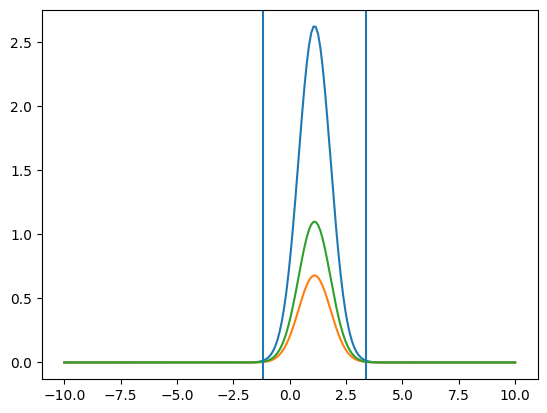

*Extracting Pieces for TH2*
Available Functions:
	Num_Xbins(TH2_) returns number of X bins for a TH2
	Num_Ybins(TH2_) returns number of Y bins for a TH2
	XEdges_2d(TH2_) returns edges of x bins for a TH2
	YEdges_2d(TH2_) returns edges of y bins for a TH2
	Center_Xbins(TH2_) returns center values for x bins for a TH2
	Center_Ybins(TH2_) returns center value for y bins for a TH2
	XY_Values(TH2_) returns a 2D np.array for z values arranged [x][y] for a TH2
	YX_Values(TH2_) returns a 2D np.array for z values arranged [y][x] for a TH2
Enjoy using TH2s

You have access to information regarding all bin numbers, bin maxes, bin mins
Each goes _VAR_max_ min, bins, res, etc. 
All the names of them as well as edges.
Q2_Bin_Name[ 5 ]
W_Bin_Name[ 29 ]
MM1_Bin_Name[ 14 ]
MM2_Bin_Name[ 14 ]
theta_Bin_Name[ 10 ]
alpha_Bin_Name[ 10 ]
phi_Bin_Name[ 10 ]
_var_set_name_ [i]
_Xij_name_[i][j]
Also _mm1_name_ etc. for all Xijs
def Q2_Corr(Q2bin_) corrects the cross section for simulation so far as Q2 is conce

In [2]:
#Gain access to functions used to change some of the aspects regarding arrays and the things in them
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Bin\ Conversions.ipynb

#Gain Access to functions used to work with momentum binning
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Momentum\ Bins.ipynb

#Gain Access to functions used to work with Fitting Functions
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Fitting\ Functions.ipynb

#Gain Access to functions used for TH2s 
#uproot3
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions-uproot3.ipynb
#uproot3
#%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH1\ Functions-uproot3.ipynb

#Gain Access to the proper binning for the the various variables
%run /Users/cmc/analysis_phd/fitting/single_diff/Friend\ Binning\ Values.ipynb

In [3]:
#date="06-13-2022"
exp_date="07-31-2024"
sim_date="07-31-2024"
par="all"
run="e16"
exp_dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_"+run+"/"+exp_date
sim_dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_"+run+"/"+sim_date
#root_file=dir+"/exp_mm_"+par+"_e16_"+date+"_"+SLURM_ID+".root"
root_file_exp=exp_dir+"/exp_"+run+"_clas6_kin_eff_"+par+"_"+exp_date+".root"
root_file_sim=sim_dir+"/sim_"+run+"_clas6_kin_eff_"+par+"_"+sim_date+".root"
xfile=uproot3.open(root_file_exp)
rfile=uproot3.open(root_file_sim)

In [4]:
sel = 1
pid_cut = ["pid","event"]
#top = ["mnone","mall"]
top = ["mnone","mall"]

sec_names = ["sec1","sec2","sec3","sec4","sec5","sec6","all"]

species = ['ele','pro','pip','pim']

# layer1 = "Kinematic Efficiency"
# layer2 = "kinematic_eff_"+par
# layer3 = layer2+"_"+pid_cut[sel]
# #layer4 = layer3+"_"+top[sel]
# #layer5 = layer4+"_cut"
# #print(xfile[layer1+"/"+layer2+"/"+layer3+"/"+layer4+"/"+layer5].keys())

# if sel ==1:
#     layer4 = layer3+"_"+top[sel]
#     layer5 = layer4+"_cut"
#     #xhist = [xfile[layer1+"/"+layer2+"/"+layer3+"/"+layer4+"/"+layer5][i] for i in xfile[layer1+"/"+layer2+"/"+layer3+"/"+layer4+"/"+layer5]]
#     xhist = [xfile[layer1+"/"+layer2+"/"+layer3+"/"+layer4+"/"+layer5]["Kinematic_eff_"+par+"_event_cut_"+sec_names[i]+"_"+top[sel]] for i in range(7)]
#      #rhist = [rfile[layer1+"/"+layer2+"/"+layer3+"/"+layer4][i] in range(len(rfile[layer1+"/"+layer2+"/"+layer3+"/"+layer4].keys()))]
# else:
#     xhist = [xfile[layer1+"/"+layer2+"/"+layer3][i] for i in xfile[layer1+"/"+layer2+"/"+layer3].keys()]
#     #rhist = [rfile[layer1+"/"+layer2+"/"+layer3][i] in range(len(rfile[layer1+"/"+layer2+"/"+layer3].keys()))]

layer1 = "Kinematic Efficiency"
layer2 = ['kinematic_eff_'+species[par] for par in range(4)]
layer3 = [layer2[par]+"_event" for par in range(4)]
layer4 = [layer3[par]+"_mall" for par in range(4)]
layer5 = [layer4[par]+"_cut" for par in range(4)]
layer6 = [["Kinematic_eff_"+species[par]+"_event_cut_sec"+str(sec+1)+"_mall" for sec in range(6)] for par in range(4)]
xhist1 = [[xfile[layer1][layer2[par]][layer3[par]][layer4[par]][layer5[par]][layer6[par][sec]] for sec in range(6)] for par in range(4)]
rhist1 = [[rfile[layer1][layer2[par]][layer3[par]][layer4[par]][layer5[par]][layer6[par][sec]] for sec in range(6)] for par in range(4)]
    
l1 = "Kinematic Efficiency by Segment"
l2 = ["Kinematic Efficiency "+species[par] for par in range(4)]
l3 = [[l2[par]+" Sector:"+str(sec+1) for sec in range(6)] for par in range(4)]
xhist2 = [[[xfile[l1][l2[par]][l3[par][sec]][xfile[l1][l2[par]][l3[par][sec]].keys()[seg]] for seg in range(48)] for sec in range(6)] for par in range(4)]
rhist2 = [[[rfile[l1][l2[par]][l3[par][sec]][rfile[l1][l2[par]][l3[par][sec]].keys()[seg]] for seg in range(48)] for sec in range(6)] for par in range(4)]


In [5]:
cut_cols = ['b','g','r']
cut_name= ["tight","mid","loose"]
data_cols = ['m',"c",'y']

# Particle=''
# Theta = ''
# Momentum = ''
# if par == "pro":
#     Particle = "Proton"
#     Momentum='$p_{P}$'
#     Theta = "$\u03B8_{P}$"
# elif par == "pip":
#     Particle = "$\u03C0^+$"
#     Momentum='$p_{\u03C0^+}$'
#     Theta = "$\u03B8_{\u03C0^+}$"
# elif par == "pim":
#     Particle = "$\u03C0^-$"
#     Momentum='$p_{\u03C0^-}$'
#     Theta = "$\u03B8_{\u03C0^-}$"
# elif par == "ele":
#     Particle = "Electron"
#     #Momentum=r'$p_{e}$'
#     #Theta = r'$\u03B8_{e}$'
#     Momentum='$p_{e}$'
#     Theta = '$\u03B8_{e}$'

Particle = ['Electron','Proton',"$\u03C0^+$","$\u03C0^-$"]
Momentum = ['$p_{e}$','$p_{P}$','$p_{\u03C0^+}$','$p_{\u03C0^-}$']
Theta = ['$\u03B8_{e}$',"$\u03B8_{P}$", "$\u03B8_{\u03C0^+}$", "$\u03B8_{\u03C0^-}$"]


xname = [Momentum[par]+" (GeV)" for par in range(4)]
yname= [Theta[par]+" (degrees)" for par in range(4)]

In [6]:
xbins=Center_Xbins(xhist1[0][0])
ybins=Center_Ybins(xhist1[0][0])
#Extracting Zvals for 2d histograms
exp_zvals1_xy=[[XY_Values(xhist1[par][sec]) for sec in range(6)] for par in range(4)]
exp_zvals1_yx=[[YX_Values(xhist1[par][sec]) for sec in range(6)] for par in range(4)]

exp_zvals2_xy=[[[XY_Values(xhist2[par][sec][seg]) for seg in range(48)] for sec in range(6)] for par in range(4)]
exp_zvals2_yx=[[[YX_Values(xhist2[par][sec][seg]) for seg in range(48)] for sec in range(6)] for par in range(4)]

sim_zvals1_xy=[[XY_Values(rhist1[par][sec]) for sec in range(6)] for par in range(4)]
sim_zvals1_yx=[[YX_Values(rhist1[par][sec]) for sec in range(6)] for par in range(4)]

sim_zvals2_xy=[[[XY_Values(rhist2[par][sec][seg]) for seg in range(48)] for sec in range(6)] for par in range(4)]
sim_zvals2_yx=[[[YX_Values(rhist2[par][sec][seg]) for seg in range(48)] for sec in range(6)] for par in range(4)]

In [7]:
xmerge=1
ymerge=1

if xmerge > 1 or ymerge >1:
    x = Merge_Bins(xbins,xmerge)
    y = Merge_Bins(ybins,ymerge)

    xedges = Merge_Bin_Edges(XEdges_2d(xhist1[0][0]),xmerge)
    yedges = Merge_Bin_Edges(YEdges_2d(xhist1[0][0]),ymerge)
    exp_z1_xy=[[Merge_Z(exp_zvals1_xy[par][sec],xmerge,ymerge) for sec in range(6)] for par in range(4)]
    exp_z1_yx=[[Merge_Z(exp_zvals1_yx[par][sec],ymerge,xmerge) for sec in range(6)] for par in range(4)]
    exp_z2_xy=[[[Merge_Z(exp_zvals2_xy[par][sec][seg],xmerge,ymerge) for seg in range(48)] for sec in range(6)] for par in range(4)]
    exp_z2_yx=[[[Merge_Z(exp_zvals2_yx[par][sec][seg],ymerge,xmerge) for seg in range(48)] for sec in range(6)] for par in range(4)]
    
    sim_z1_xy=[[Merge_Z(sim_zvals1_xy[par][sec],xmerge,ymerge) for sec in range(6)] for par in range(4)]
    sim_z1_yx=[[Merge_Z(sim_zvals1_yx[par][sec],ymerge,xmerge) for sec in range(6)] for par in range(4)]
    sim_z2_xy=[[[Merge_Z(sim_zvals2_xy[par][sec][seg],xmerge,ymerge) for seg in range(48)] for sec in range(6)] for par in range(4)]
    sim_z2_yx=[[[Merge_Z(sim_zvals2_yx[par][sec][seg],ymerge,xmerge) for seg in range(48)] for sec in range(6)] for par in range(4)]
    # sim_z_xy=[Merge_Z(sim_zvals_xy[i],xmerge,ymerge) for i in range(7)]
    # sim_z_yx=[Merge_Z(sim_zvals_yx[i],ymerge,xmerge) for i in range(7)]
    #exp_fit_x = [[Remove_Zeros_X(y,exp_z_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(7)]
    #exp_fit_y = [[Remove_Zeros_Y(exp_z_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(7)]

    # sim_fit_x = [[Remove_Zeros_X(y,sim_z_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(6)]
    # sim_fit_y = [[Remove_Zeros_Y(sim_z_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(6)]
else:
    x = xbins
    y = ybins
    xedges = XEdges_2d(xhist1[0][0])
    yedges = YEdges_2d(xhist1[0][0])
    exp_z1_xy=exp_zvals1_xy
    exp_z1_yx=exp_zvals1_yx
    exp_z2_xy=exp_zvals2_xy
    exp_z2_yx=exp_zvals2_yx
    
    sim_z1_xy=sim_zvals1_xy
    sim_z1_yx=sim_zvals1_yx
    sim_z2_xy=sim_zvals2_xy
    sim_z2_yx=sim_zvals2_yx
                      
                      
xdim = len(x)
ydim = len(y)

xres = xedges[1]-xedges[0]
yres = yedges[1]-yedges[0]    

In [23]:
z2_xy_xr = np.zeros((4,6,48,len(x),len(y)))
z2_yx_xr = np.zeros((4,6,48,len(y),len(x)))
z2_xy_rx = np.zeros((4,6,48,len(x),len(y)))
z2_yx_rx = np.zeros((4,6,48,len(y),len(x)))

z1_xy_xr = np.zeros((4,6,len(x),len(y)))
z1_yx_xr = np.zeros((4,6,len(y),len(x)))
z1_xy_rx = np.zeros((4,6,len(x),len(y)))
z1_yx_rx = np.zeros((4,6,len(y),len(x)))

for par in range(4):
    for sec in range(6):
        for seg in range(48):
            if np.max(exp_zvals2_yx[par][sec][seg]) >0 and np.max(sim_zvals2_yx[par][sec][seg]) >0:
                ratio = np.max(exp_zvals2_yx[par][sec][seg])/np.max(sim_zvals2_yx[par][sec][seg])
                for xbin in range(len(x)):
                    for ybin in range(len(y)):
                        if exp_zvals2_yx[par][sec][seg][ybin][xbin] > ratio*sim_zvals2_yx[par][sec][seg][ybin][xbin]:
                            z2_xy_xr[par][sec][seg][xbin][ybin] = exp_zvals2_yx[par][sec][seg][ybin][xbin]-ratio*sim_zvals2_yx[par][sec][seg][ybin][xbin]
                            z2_yx_xr[par][sec][seg][ybin][xbin] = exp_zvals2_yx[par][sec][seg][ybin][xbin]-ratio*sim_zvals2_yx[par][sec][seg][ybin][xbin]
                        elif sim_zvals2_yx[par][sec][seg][ybin][xbin] > 0.0:
                            z2_xy_rx[par][sec][seg][xbin][ybin] = ratio*sim_zvals2_yx[par][sec][seg][ybin][xbin]-exp_zvals2_yx[par][sec][seg][ybin][xbin]
                            z2_yx_rx[par][sec][seg][ybin][xbin] = ratio*sim_zvals2_yx[par][sec][seg][ybin][xbin]-exp_zvals2_yx[par][sec][seg][ybin][xbin]
        if np.max(exp_zvals1_yx[par][sec]) >0 and np.max(sim_zvals1_yx[par][sec]) >0:
            ratio1 = np.max(exp_zvals1_yx[par][sec])/np.max(sim_zvals1_yx[par][sec])
            for xbin in range(len(x)):
                for ybin in range(len(y)):
                    if exp_zvals1_yx[par][sec][ybin][xbin] > ratio1*sim_zvals1_yx[par][sec][ybin][xbin]:
                        z1_xy_xr[par][sec][xbin][ybin] = exp_zvals1_yx[par][sec][ybin][xbin] - ratio1*sim_zvals1_yx[par][sec][ybin][xbin]
                        z1_yx_xr[par][sec][ybin][xbin] = exp_zvals1_yx[par][sec][ybin][xbin] - ratio1*sim_zvals1_yx[par][sec][ybin][xbin]
                    elif sim_zvals1_yx[par][sec][ybin][xbin] > 0.0:
                        z1_xy_rx[par][sec][xbin][ybin] = ratio1*sim_zvals1_yx[par][sec][ybin][xbin] - exp_zvals1_yx[par][sec][ybin][xbin]
                        z1_yx_rx[par][sec][ybin][xbin] = ratio1*sim_zvals1_yx[par][sec][ybin][xbin] - exp_zvals1_yx[par][sec][ybin][xbin]
            
            
            
            
            

In [8]:
no_sc_seg = np.zeros((6,48))

for sec in range(6):
    for seg in range(48):
        if sec == 0:
            if seg != 46-1:
                no_sc_seg[sec][seg] = 1
        elif sec ==1:
            if seg!= 46-1:
                no_sc_seg[sec][seg] = 1
        elif sec ==2:
            if seg!= 25-1 and seg!=37 and seg!= 38 and seg!=42 and seg!=44 and seg!=45 and seg!=46 and seg!=47 :
                no_sc_seg[sec][seg] = 1
        elif sec ==3:
            if seg!= 35-1:
                no_sc_seg[sec][seg] = 1
        elif sec ==4:
            if seg!= 33-1 and seg!= 41-1 and seg!= 43-1 and seg!= 47-1:
                no_sc_seg[sec][seg] = 1
        elif sec ==5:
            if seg!= 37-1 and seg!= 38-1 and seg!= 45-1:
                no_sc_seg[sec][seg] = 1

In [21]:
exp_z2_sum_xy = np.zeros((4,6,len(x),len(y)))
exp_z2_sum_yx = np.zeros((4,6,len(y),len(x)))

sim_z2_sum_xy = np.zeros((4,6,len(x),len(y)))
sim_z2_sum_yx = np.zeros((4,6,len(y),len(x)))

z2_sum_xy_xr = np.zeros((4,6,len(x),len(y)))
z2_sum_yx_xr = np.zeros((4,6,len(y),len(x)))

z2_sum_xy_rx = np.zeros((4,6,len(x),len(y)))
z2_sum_yx_rx = np.zeros((4,6,len(y),len(x)))



for par in range(4):
    for sec in range(6):
        for seg in range(48):
            if no_sc_seg[sec][seg]==1:
                for xbin in range(len(x)):
                    for ybin in range(len(y)):
                        exp_z2_sum_xy[par][sec][xbin][ybin] += exp_z2_xy[par][sec][seg][xbin][ybin]
                        exp_z2_sum_yx[par][sec][ybin][xbin] += exp_z2_yx[par][sec][seg][ybin][xbin]
                        
                        sim_z2_sum_xy[par][sec][xbin][ybin] += sim_z2_xy[par][sec][seg][xbin][ybin]
                        sim_z2_sum_yx[par][sec][ybin][xbin] += sim_z2_yx[par][sec][seg][ybin][xbin]
                        
                        z2_sum_xy_xr[par][sec][xbin][ybin] += z2_xy_xr[par][sec][seg][xbin][ybin]
                        z2_sum_yx_xr[par][sec][ybin][xbin] += z2_yx_xr[par][sec][seg][ybin][xbin]
                        z2_sum_xy_rx[par][sec][xbin][ybin] += z2_xy_rx[par][sec][seg][xbin][ybin]
                        z2_sum_yx_rx[par][sec][ybin][xbin] += z2_yx_rx[par][sec][seg][ybin][xbin]
                        
                        
                        
                        

In [41]:
par = 0
sec = 0
print("exp no sub",np.max(exp_zvals1_yx[par][sec]))
print("exp - sub",np.max(z1_yx_xr[par][sec]))
print("sub - exp",np.max(z1_yx_rx[par][sec]))


z3_xy = np.zeros((4,6,len(x),len(y)))
z3_yx = np.zeros((4,6,len(y),len(x)))

dev = 0.8
for par in range(4):
    for sec in range(6):
        #ratio1 = np.max(exp_zvals1_yx[par][sec])/np.max(sim_zvals1_yx[par][sec])
        #ratio2 = np.max(sim_zvals1_yx[par][sec])/np.max(exp_zvals1_yx[par][sec])
        ratio1 = np.max(exp_z2_sum_yx[par][sec])/np.max(sim_z2_sum_yx[par][sec])
        ratio2 = np.max(sim_z2_sum_yx[par][sec])/np.max(exp_z2_sum_yx[par][sec])
        for xbin in range(len(x)):
            for ybin in range(len(y)):
                #if dev*exp_zvals1_yx[par][sec][ybin][xbin] < z1_yx_rx[par][sec][ybin][xbin] or dev*exp_zvals1_yx[par][sec][ybin][xbin] < z1_yx_xr[par][sec][ybin][xbin] or dev*ratio1*sim_zvals1_yx[par][sec][ybin][xbin] < z1_yx_rx[par][sec][ybin][xbin] or dev*ratio1*sim_zvals1_yx[par][sec][ybin][xbin] < z1_yx_xr[par][sec][ybin][xbin]:
                if dev*exp_z2_sum_yx[par][sec][ybin][xbin] < z1_yx_rx[par][sec][ybin][xbin] or dev*exp_z2_sum_yx[par][sec][ybin][xbin] < z1_yx_xr[par][sec][ybin][xbin] or dev*ratio1*sim_z2_sum_yx[par][sec][ybin][xbin] < z1_yx_rx[par][sec][ybin][xbin] or dev*ratio1*sim_z2_sum_yx[par][sec][ybin][xbin] < z1_yx_xr[par][sec][ybin][xbin]:
                    z3_xy[par][sec][xbin][ybin] = 1
                    z3_yx[par][sec][ybin][xbin] = 1
                #else:
                 #   z3_xy[par][sec][xbin][ybin] = 0
                  #  z3_yx[par][sec][ybin][xbin] = 1
                
                
                
                

exp no sub 499.0
exp - sub 91.34432983398438
sub - exp 239.07400512695312


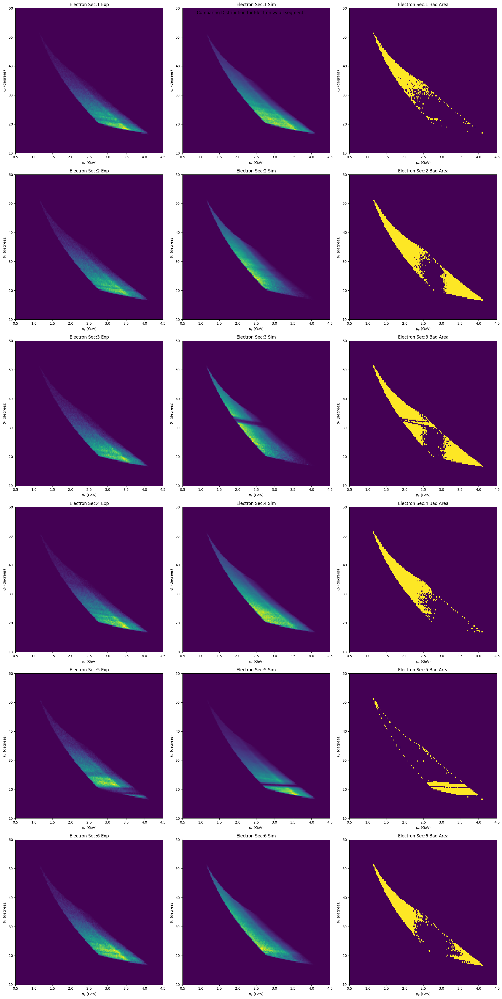

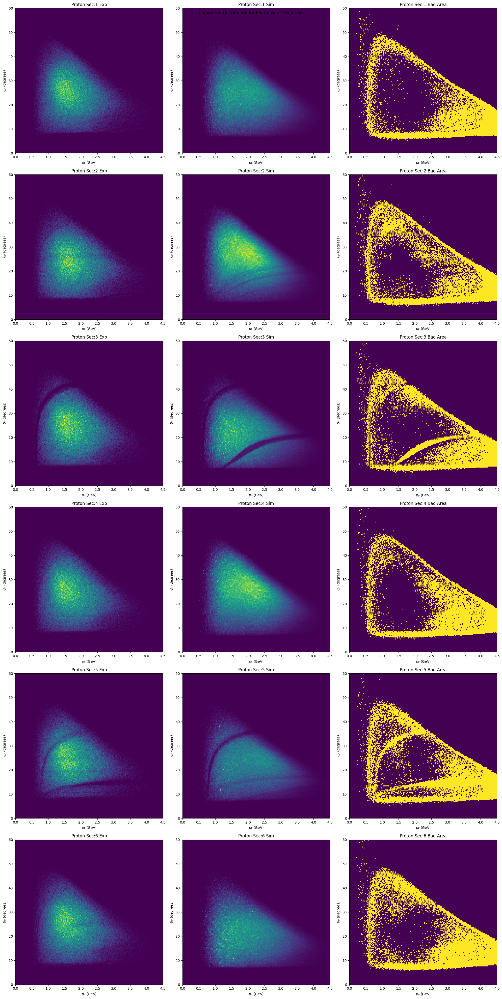

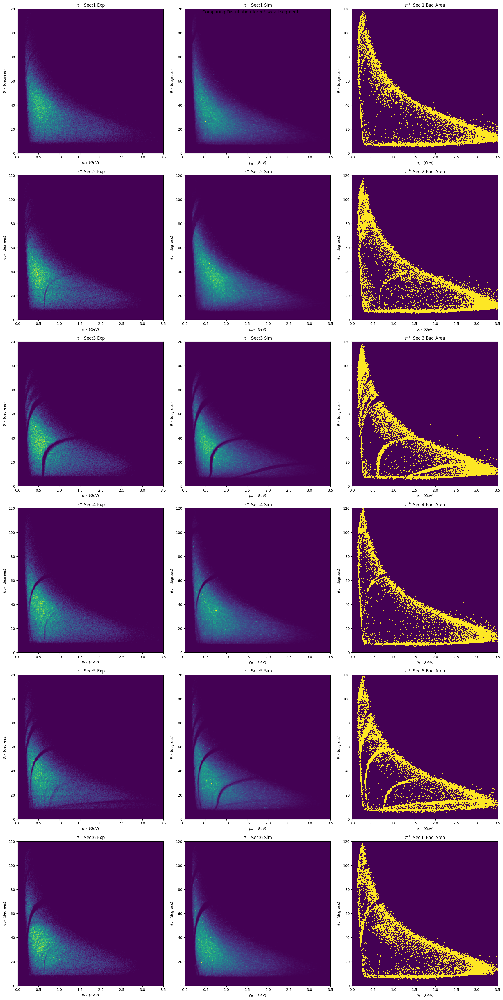

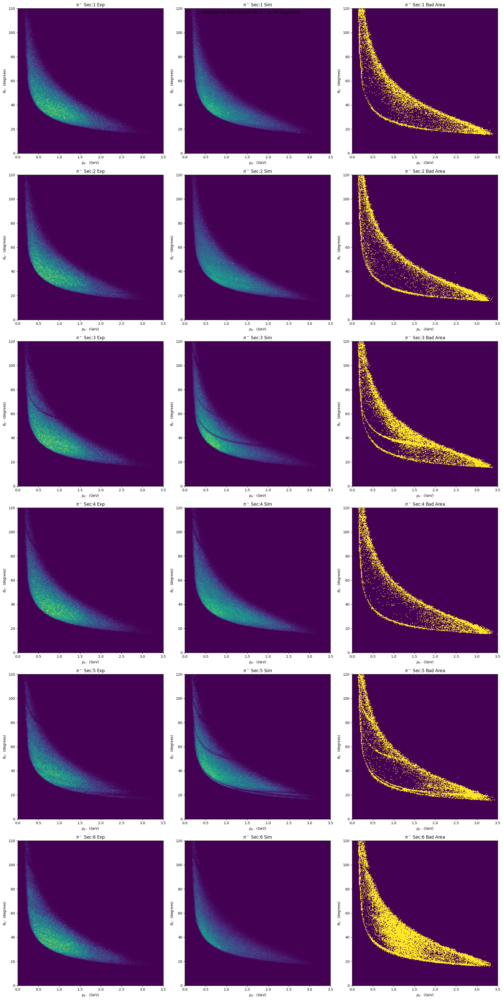

In [42]:
for par in range(4):
    figure, axis = plt.subplots(6,3)
    figure.set_size_inches(20,40)
    figure.suptitle("Comparing Distribution for {} w/ all segments".format(Particle[par]))
    for sec in range(6):
        axis[sec][0].pcolor(x,y,exp_z2_sum_yx[par][sec])
        axis[sec][1].pcolor(x,y,sim_z2_sum_yx[par][sec])
        axis[sec][2].pcolor(x,y,z3_yx[par][sec])
        axis[sec][0].set_xlabel(xname[par])
        axis[sec][1].set_xlabel(xname[par])
        axis[sec][2].set_xlabel(xname[par])
        axis[sec][0].set_ylabel(yname[par])
        axis[sec][1].set_ylabel(yname[par])
        axis[sec][2].set_ylabel(yname[par])
        axis[sec][0].set_title("{} Sec:{} Exp".format(Particle[par],sec+1))
        axis[sec][1].set_title("{} Sec:{} Sim".format(Particle[par],sec+1))
        axis[sec][2].set_title("{} Sec:{} Bad Area".format(Particle[par],sec+1))
        axis[sec][0].set_xlim(xlims[par])
        axis[sec][1].set_xlim(xlims[par])
        axis[sec][2].set_xlim(xlims[par])
        axis[sec][0].set_ylim(ylims[par])
        axis[sec][1].set_ylim(ylims[par])
        axis[sec][2].set_ylim(ylims[par])
    plt.tight_layout()
    plt.show()

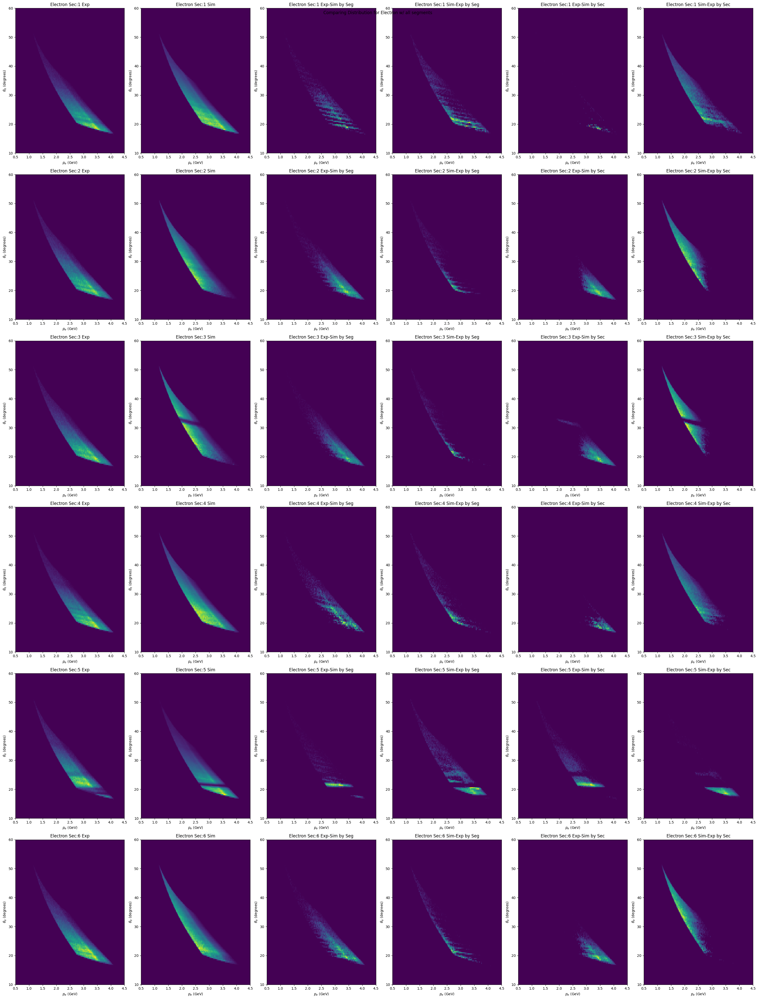

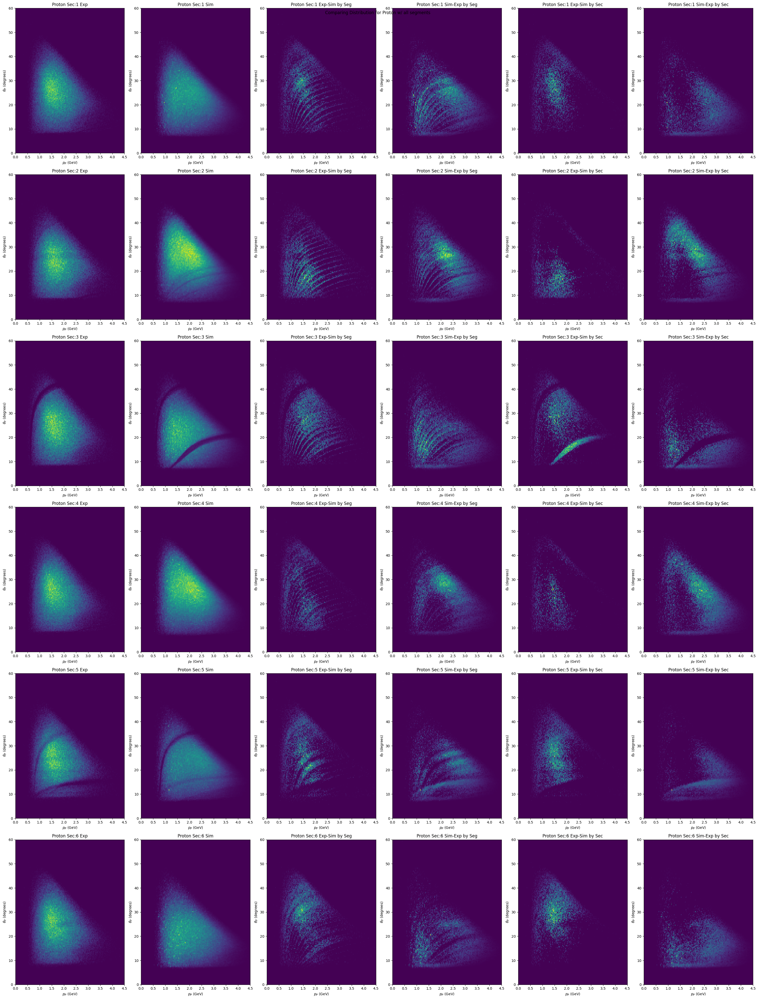

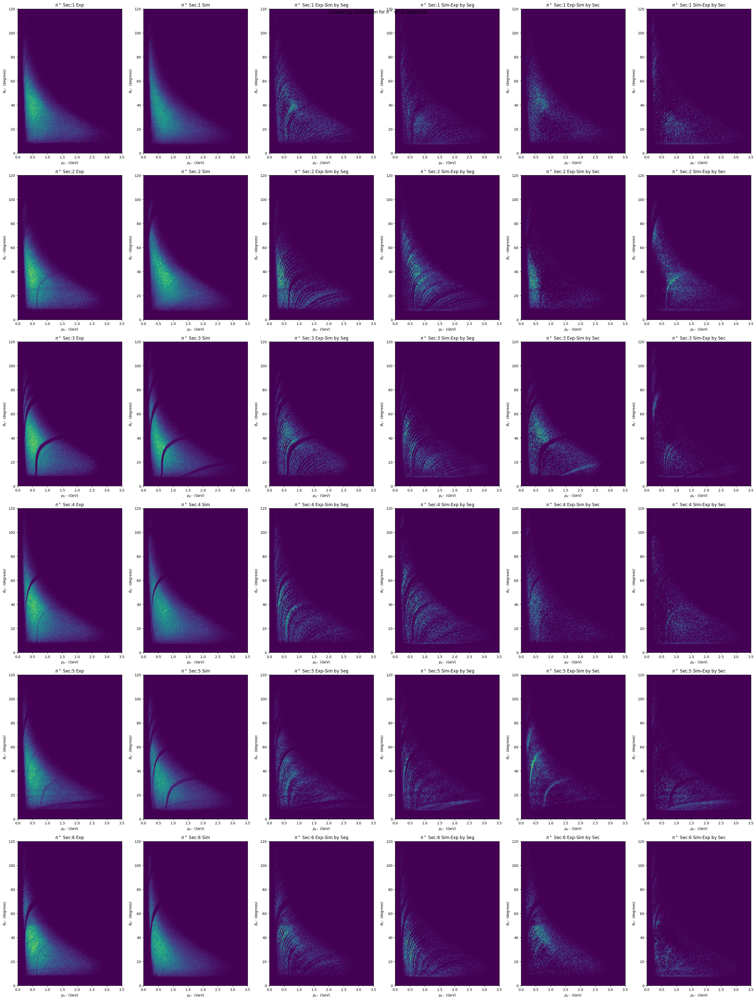

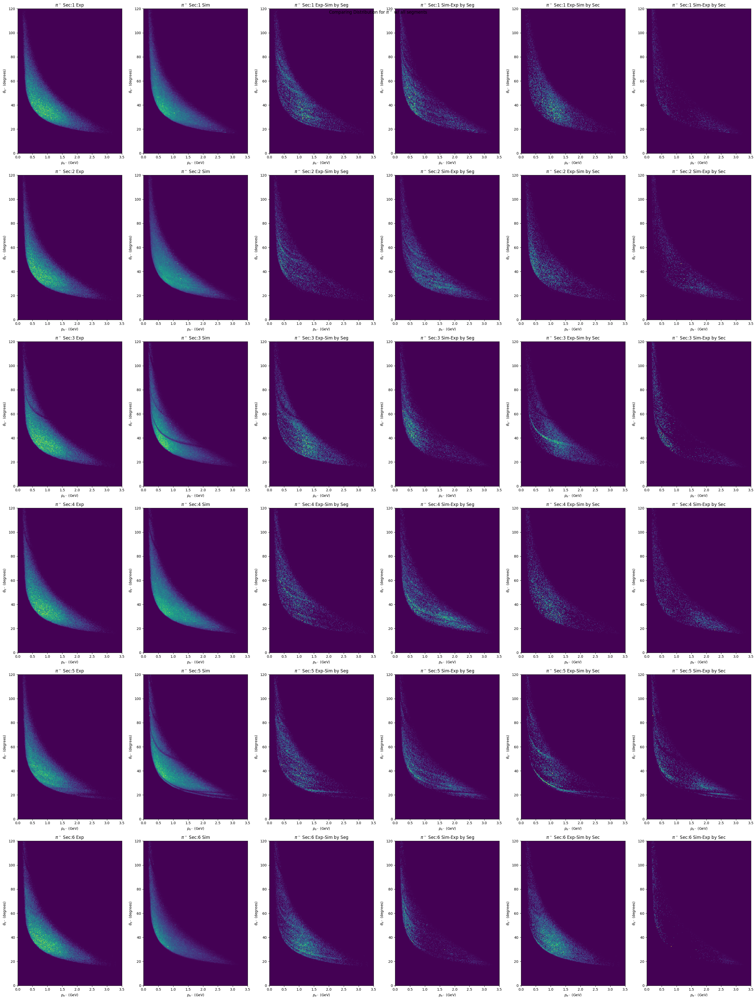

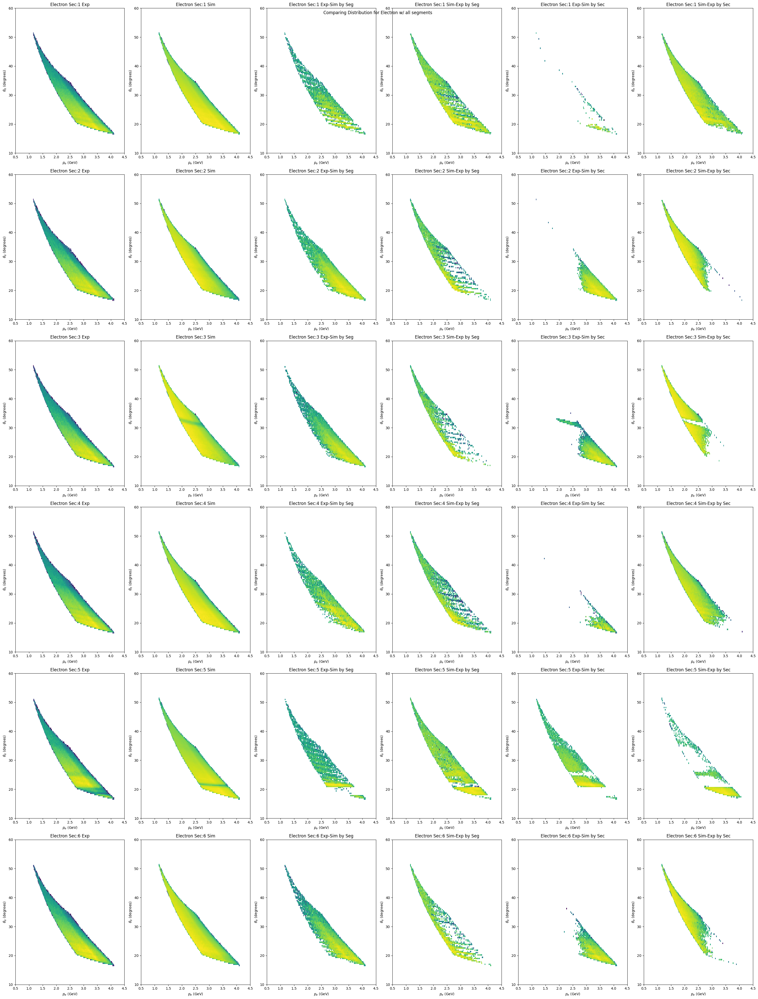

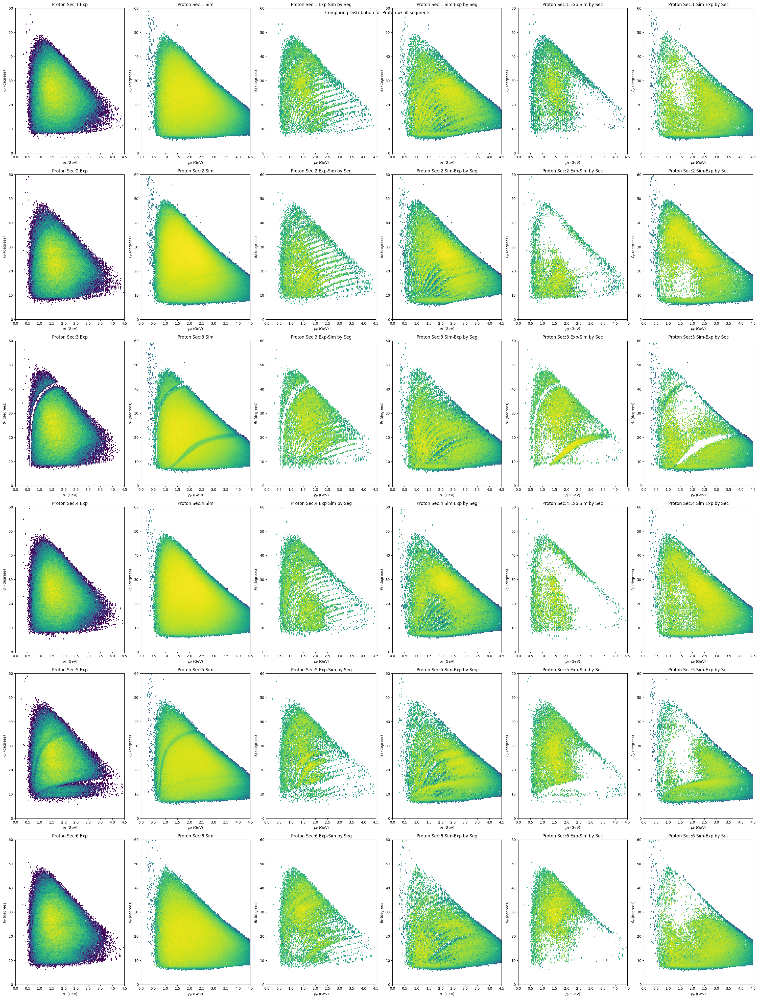

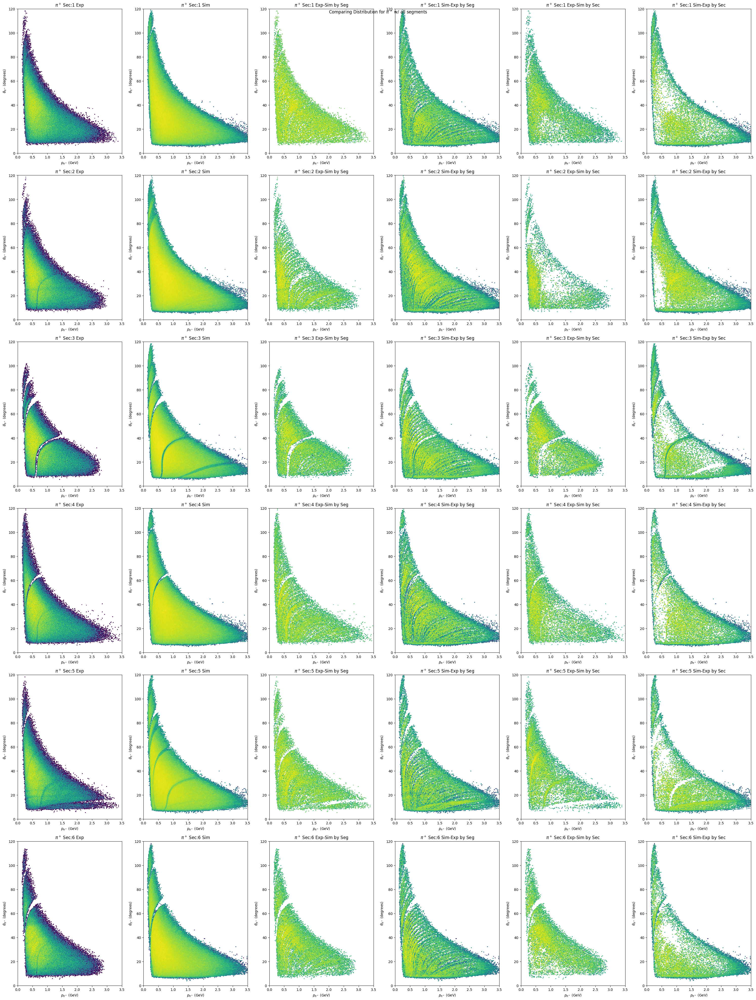

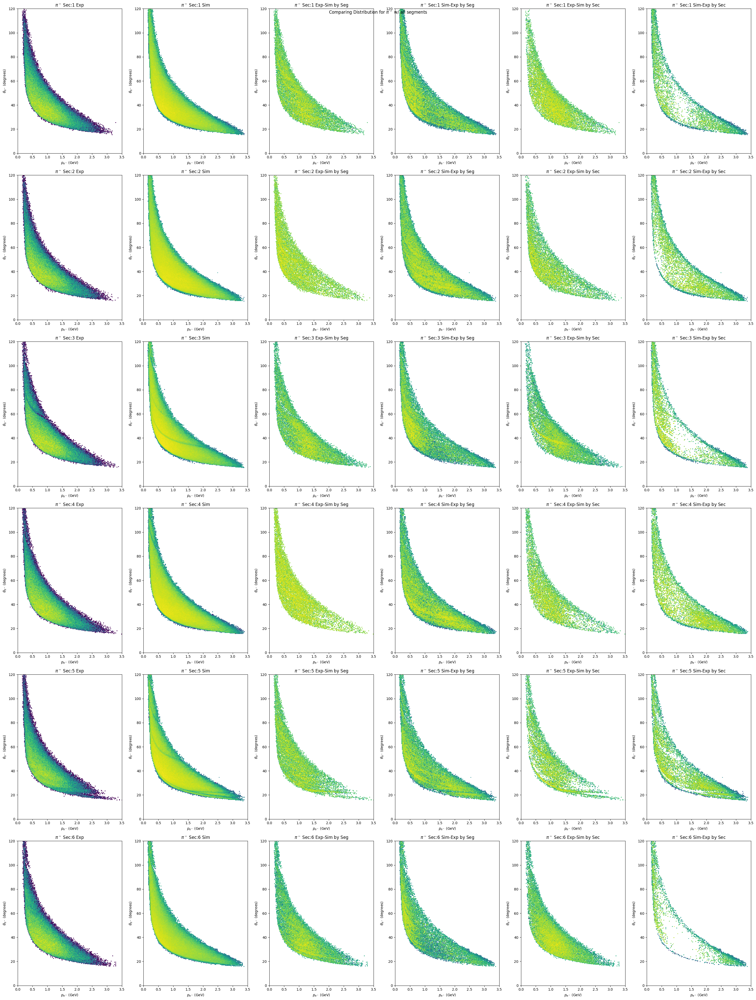

In [29]:
xlims = [[0.5,4.5],[0.0,4.5],[0.0,3.5],[0.0,3.5]]
ylims = [[10,60],[0.0,60],[0.0,120],[0.0,120]]


# figure, axis = plt.subplots(6,4)
# figure.set_size_inches(20,50)
for par in range(4):
    figure, axis = plt.subplots(6,6)
    figure.set_size_inches(30,40)
    figure.suptitle("Comparing Distribution for {} w/ all segments".format(Particle[par]))
    for sec in range(6):
        axis[sec][0].pcolor(x,y,exp_z1_yx[par][sec])
        axis[sec][1].pcolor(x,y,sim_z1_yx[par][sec])
        axis[sec][0].set_xlabel(xname[par])
        axis[sec][1].set_xlabel(xname[par])
        axis[sec][0].set_ylabel(yname[par])
        axis[sec][1].set_ylabel(yname[par])
        axis[sec][0].set_title("{} Sec:{} Exp".format(Particle[par],sec+1))
        axis[sec][1].set_title("{} Sec:{} Sim".format(Particle[par],sec+1))
        axis[sec][0].set_xlim(xlims[par])
        axis[sec][1].set_xlim(xlims[par])
        axis[sec][0].set_ylim(ylims[par])
        axis[sec][1].set_ylim(ylims[par])
        
        axis[sec][2].pcolor(x,y,z2_sum_yx_xr[par][sec])
        axis[sec][3].pcolor(x,y,z2_sum_yx_rx[par][sec])
        axis[sec][2].set_xlabel(xname[par])
        axis[sec][3].set_xlabel(xname[par])
        axis[sec][2].set_ylabel(yname[par])
        axis[sec][3].set_ylabel(yname[par])
        axis[sec][2].set_title("{} Sec:{} Exp-Sim by Seg".format(Particle[par],sec+1))
        axis[sec][3].set_title("{} Sec:{} Sim-Exp by Seg".format(Particle[par],sec+1))
        axis[sec][2].set_xlim(xlims[par])
        axis[sec][3].set_xlim(xlims[par])
        axis[sec][2].set_ylim(ylims[par])
        axis[sec][3].set_ylim(ylims[par])
        
        axis[sec][4].pcolor(x,y,z1_yx_xr[par][sec])
        axis[sec][5].pcolor(x,y,z1_yx_rx[par][sec])
        axis[sec][4].set_xlabel(xname[par])
        axis[sec][5].set_xlabel(xname[par])
        axis[sec][4].set_ylabel(yname[par])
        axis[sec][5].set_ylabel(yname[par])
        axis[sec][4].set_title("{} Sec:{} Exp-Sim by Sec".format(Particle[par],sec+1))
        axis[sec][5].set_title("{} Sec:{} Sim-Exp by Sec".format(Particle[par],sec+1))
        axis[sec][4].set_xlim(xlims[par])
        axis[sec][5].set_xlim(xlims[par])
        axis[sec][4].set_ylim(ylims[par])
        axis[sec][5].set_ylim(ylims[par])
        
#         axis[sec][0].set_colorbar()
#         axis[sec][1].set_colorbar()
#         axis[sec][2].set_colorbar()
#         axis[sec][3].set_colorbar()
#         axis[sec][4].set_colorbar()
#         axis[sec][5].set_colorbar()
        
    plt.tight_layout()    
    plt.show()


for par in range(4):
    figure, axis = plt.subplots(6,6)
    figure.set_size_inches(30,40)
    figure.suptitle("Comparing Distribution for {} w/ all segments".format(Particle[par]))
    for sec in range(6):
        axis[sec][0].pcolor(x,y,exp_z1_yx[par][sec],norm = mpl.colors.LogNorm())
        axis[sec][1].pcolor(x,y,sim_z1_yx[par][sec],norm = mpl.colors.LogNorm())
        axis[sec][0].set_xlabel(xname[par])
        axis[sec][1].set_xlabel(xname[par])
        axis[sec][0].set_ylabel(yname[par])
        axis[sec][1].set_ylabel(yname[par])
        axis[sec][0].set_title("{} Sec:{} Exp".format(Particle[par],sec+1))
        axis[sec][1].set_title("{} Sec:{} Sim".format(Particle[par],sec+1))
        axis[sec][0].set_xlim(xlims[par])
        axis[sec][1].set_xlim(xlims[par])
        axis[sec][0].set_ylim(ylims[par])
        axis[sec][1].set_ylim(ylims[par])
        
        
        axis[sec][2].pcolor(x,y,z2_sum_yx_xr[par][sec],norm = mpl.colors.LogNorm())
        axis[sec][3].pcolor(x,y,z2_sum_yx_rx[par][sec],norm = mpl.colors.LogNorm())
        axis[sec][2].set_xlabel(xname[par])
        axis[sec][3].set_xlabel(xname[par])
        axis[sec][2].set_ylabel(yname[par])
        axis[sec][3].set_ylabel(yname[par])
        axis[sec][2].set_title("{} Sec:{} Exp-Sim by Seg".format(Particle[par],sec+1))
        axis[sec][3].set_title("{} Sec:{} Sim-Exp by Seg".format(Particle[par],sec+1))
        axis[sec][2].set_xlim(xlims[par])
        axis[sec][3].set_xlim(xlims[par])
        axis[sec][2].set_ylim(ylims[par])
        axis[sec][3].set_ylim(ylims[par])
        
        axis[sec][4].pcolor(x,y,z1_yx_xr[par][sec],norm = mpl.colors.LogNorm())
        axis[sec][5].pcolor(x,y,z1_yx_rx[par][sec],norm = mpl.colors.LogNorm())
        axis[sec][4].set_xlabel(xname[par])
        axis[sec][5].set_xlabel(xname[par])
        axis[sec][4].set_ylabel(yname[par])
        axis[sec][5].set_ylabel(yname[par])
        axis[sec][4].set_title("{} Sec:{} Exp-Sim by Sec".format(Particle[par],sec+1))
        axis[sec][5].set_title("{} Sec:{} Sim-Exp by Sec".format(Particle[par],sec+1))
        axis[sec][4].set_xlim(xlims[par])
        axis[sec][5].set_xlim(xlims[par])
        axis[sec][4].set_ylim(ylims[par])
        axis[sec][5].set_ylim(ylims[par])
        
#         axis[sec][0].set_colorbar()
#         axis[sec][1].set_colorbar()
#         axis[sec][2].set_colorbar()
#         axis[sec][3].set_colorbar()
#         axis[sec][4].set_colorbar()
#         axis[sec][5].set_colorbar()
        
    plt.tight_layout()    
    plt.show()
    
    

In [ ]:
for par in range(4):
    figure, axis = plt.subplots(6,4)
    
    figure.suptitle("Comparing Distribution for {} w/ cut segments".format(Particle[par]))
    figure.set_size_inches(20,40)
    for sec in range(6):
        axis[sec][0].pcolor(x,y,exp_z2_sum_yx[par][sec])
        axis[sec][1].pcolor(x,y,sim_z2_sum_yx[par][sec])
        axis[sec][0].set_xlabel(xname[par])
        axis[sec][1].set_xlabel(xname[par])
        axis[sec][0].set_ylabel(yname[par])
        axis[sec][1].set_ylabel(yname[par])
        axis[sec][0].set_title("{} Sec:{} Exp".format(Particle[par],sec+1))
        axis[sec][1].set_title("{} Sec:{} Sim".format(Particle[par],sec+1))
        axis[sec][0].set_xlim(xlims[par])
        axis[sec][1].set_xlim(xlims[par])
        axis[sec][0].set_ylim(ylims[par])
        axis[sec][1].set_ylim(ylims[par])
        
        axis[sec][2].pcolor(x,y,z2_sum_yx_xr[par][sec])
        axis[sec][3].pcolor(x,y,z2_sum_yx_rx[par][sec])
        axis[sec][2].set_xlabel(xname[par])
        axis[sec][3].set_xlabel(xname[par])
        axis[sec][2].set_ylabel(yname[par])
        axis[sec][3].set_ylabel(yname[par])
        axis[sec][2].set_title("{} Sec:{} Exp-Sim".format(Particle[par],sec+1))
        axis[sec][3].set_title("{} Sec:{} Sim-Exp".format(Particle[par],sec+1))
        axis[sec][2].set_xlim(xlims[par])
        axis[sec][3].set_xlim(xlims[par])
        axis[sec][2].set_ylim(ylims[par])
        axis[sec][3].set_ylim(ylims[par])
        
    plt.tight_layout()    
    plt.show()

**Starting**
Electron Seg:1


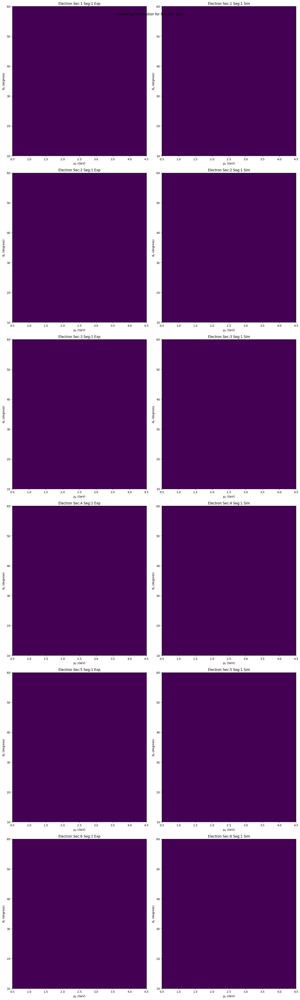

**Finished**
Electron Seg:1
**--------**
**Starting**
Electron Seg:2


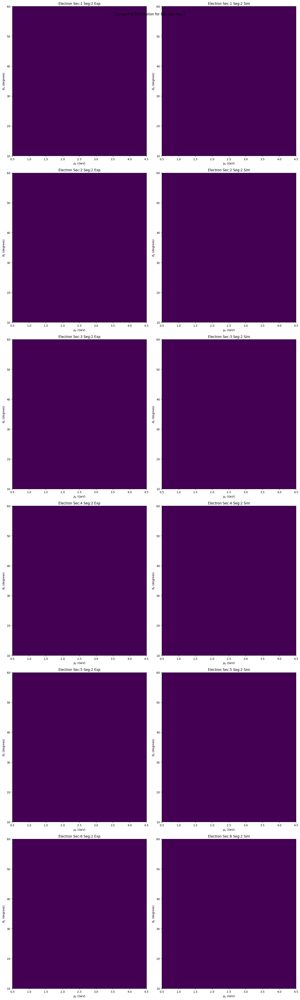

**Finished**
Electron Seg:2
**--------**
**Starting**
Electron Seg:3


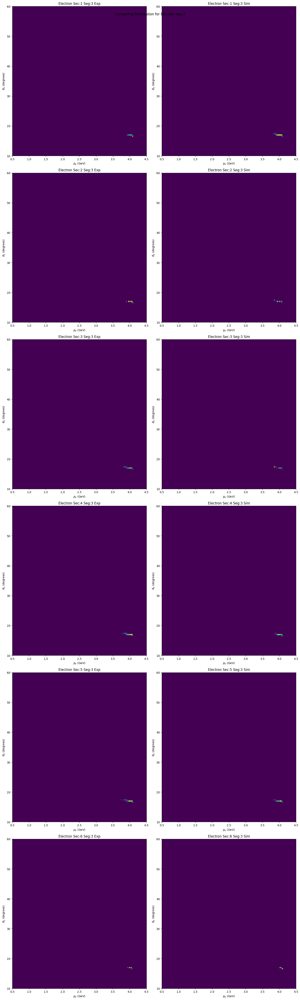

**Finished**
Electron Seg:3
**--------**
**Starting**
Electron Seg:4


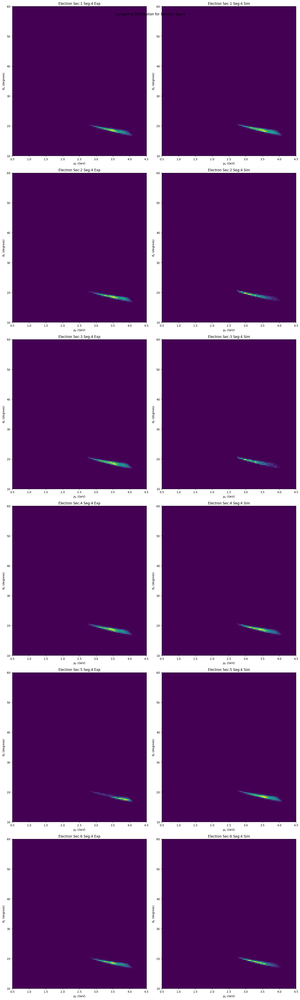

**Finished**
Electron Seg:4
**--------**
**Starting**
Electron Seg:5


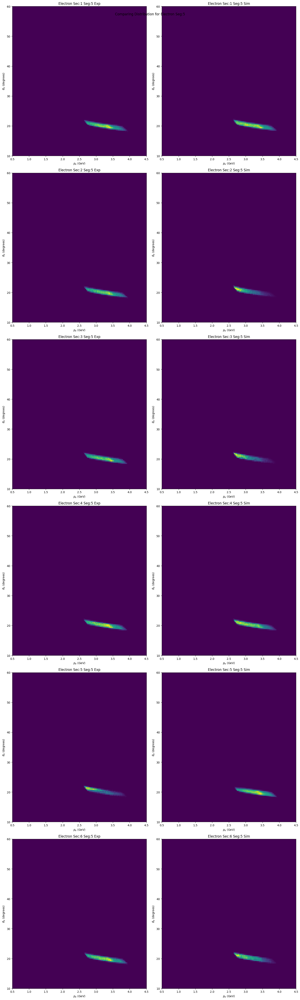

**Finished**
Electron Seg:5
**--------**
**Starting**
Electron Seg:6


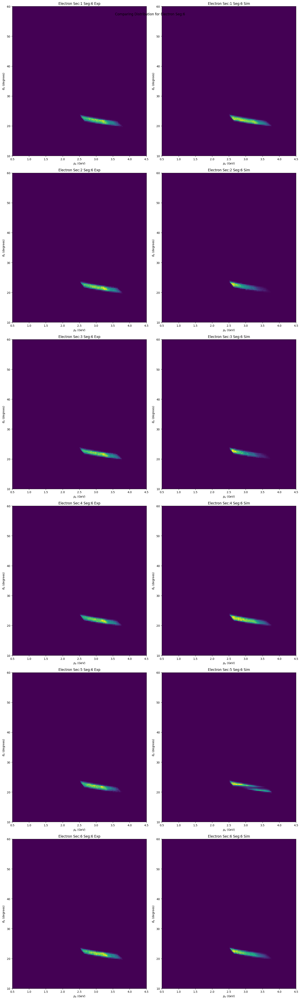

**Finished**
Electron Seg:6
**--------**
**Starting**
Electron Seg:7


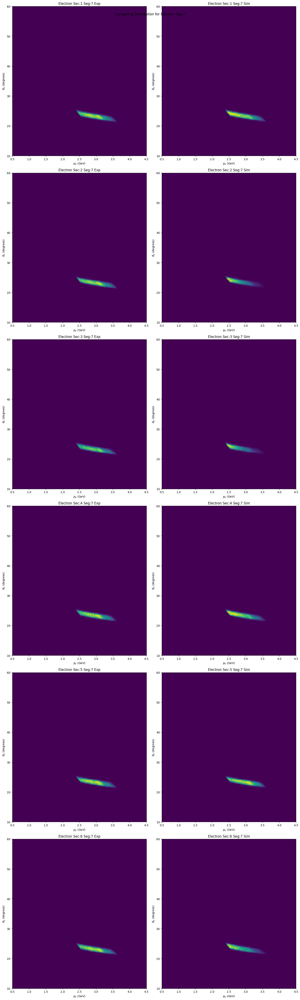

**Finished**
Electron Seg:7
**--------**
**Starting**
Electron Seg:8


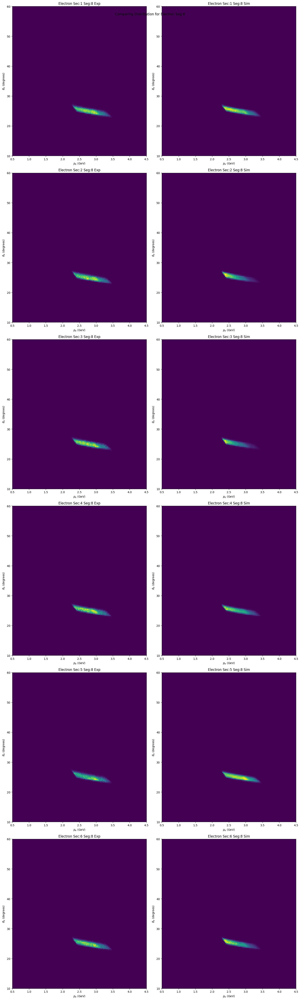

**Finished**
Electron Seg:8
**--------**
**Starting**
Electron Seg:9


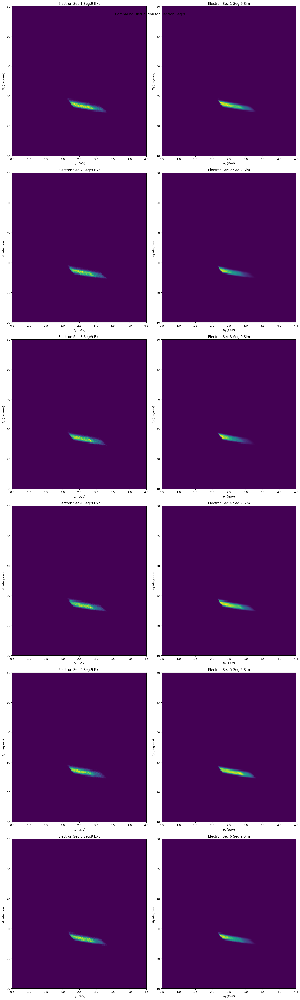

**Finished**
Electron Seg:9
**--------**
**Starting**
Electron Seg:10


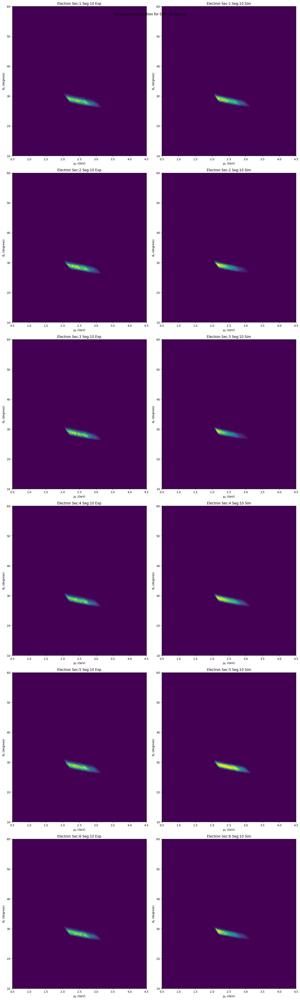

**Finished**
Electron Seg:10
**--------**
**Starting**
Electron Seg:11


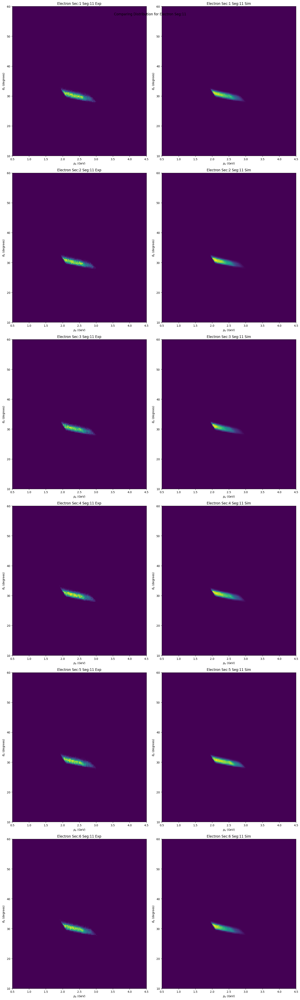

**Finished**
Electron Seg:11
**--------**
**Starting**
Electron Seg:12


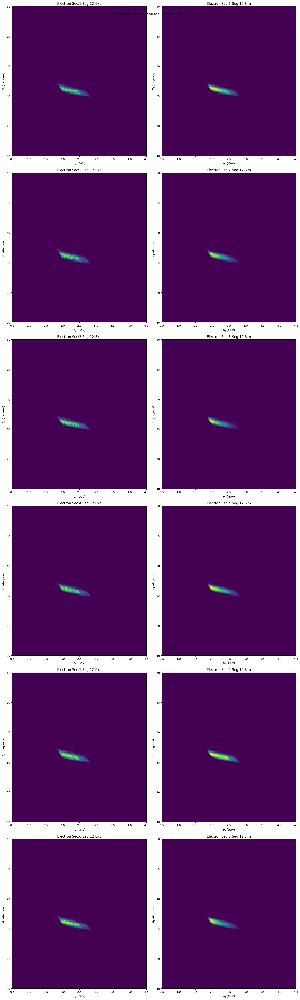

**Finished**
Electron Seg:12
**--------**
**Starting**
Electron Seg:13


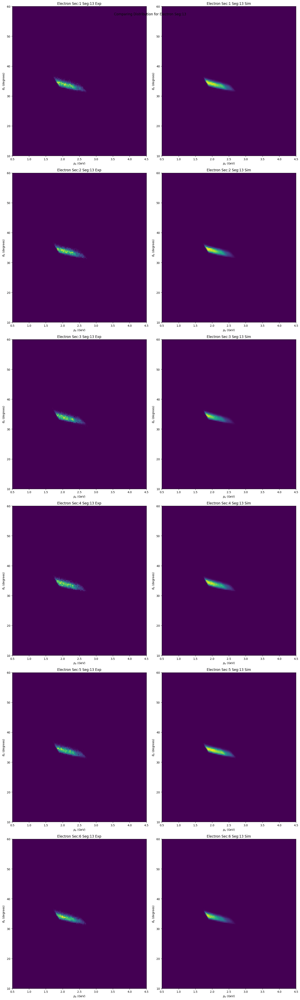

**Finished**
Electron Seg:13
**--------**
**Starting**
Electron Seg:14


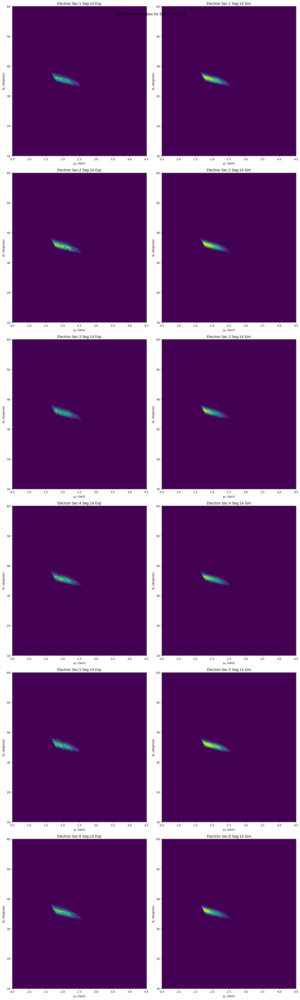

**Finished**
Electron Seg:14
**--------**
**Starting**
Electron Seg:15


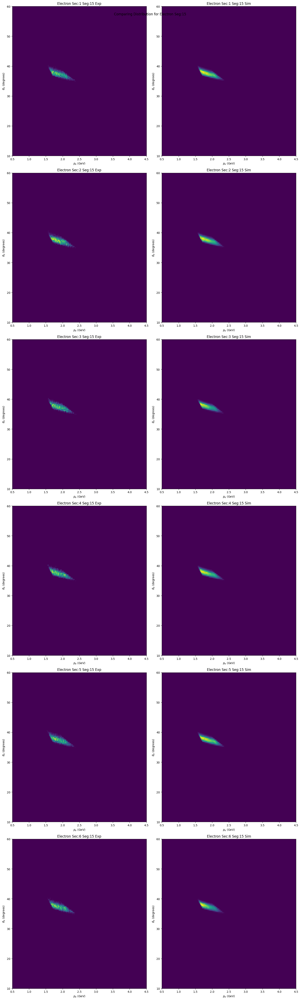

**Finished**
Electron Seg:15
**--------**
**Starting**
Electron Seg:16


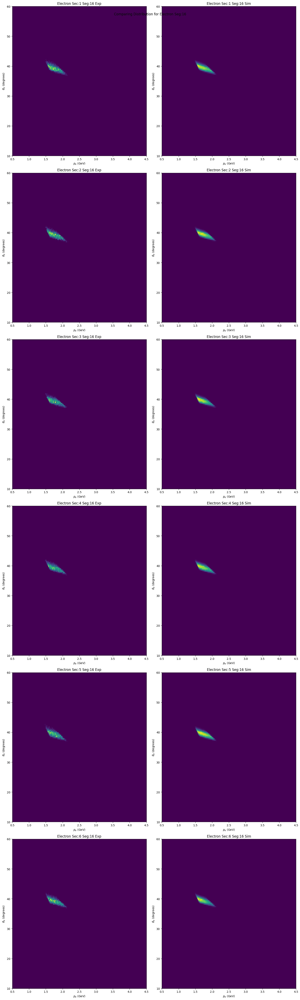

**Finished**
Electron Seg:16
**--------**
**Starting**
Electron Seg:17


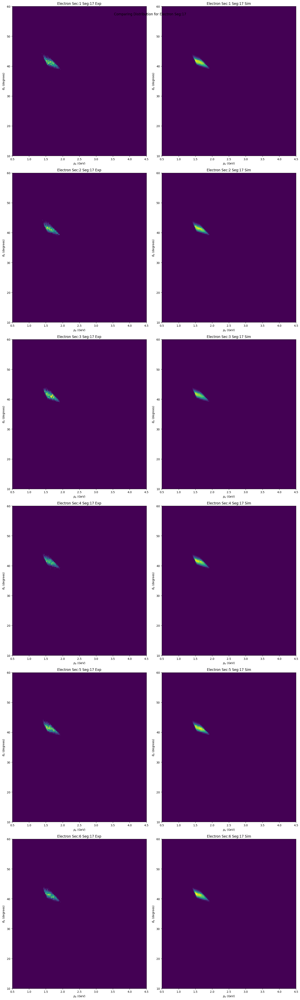

**Finished**
Electron Seg:17
**--------**
**Starting**
Electron Seg:18


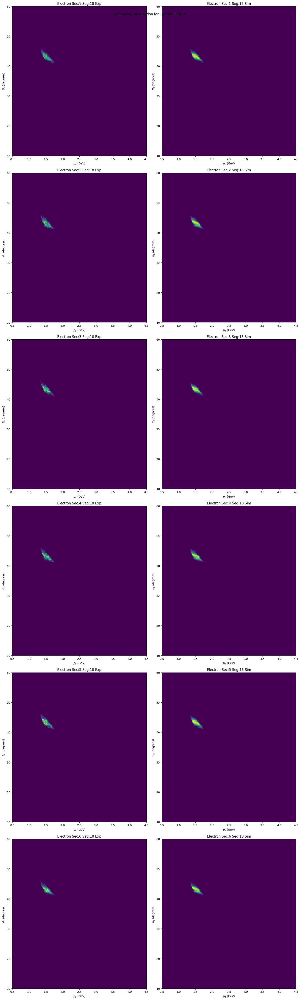

**Finished**
Electron Seg:18
**--------**
**Starting**
Electron Seg:19


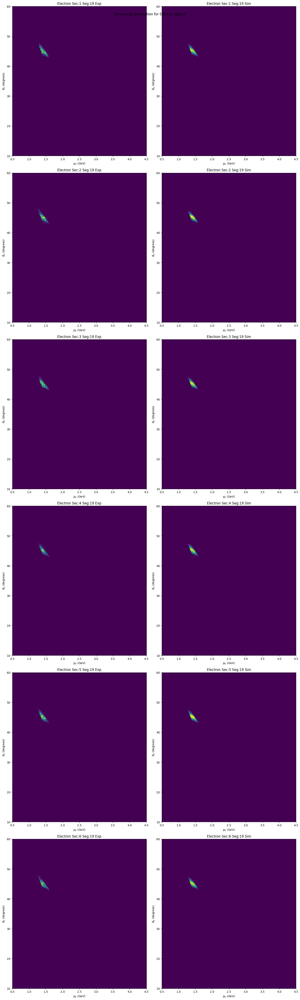

**Finished**
Electron Seg:19
**--------**
**Starting**
Electron Seg:20


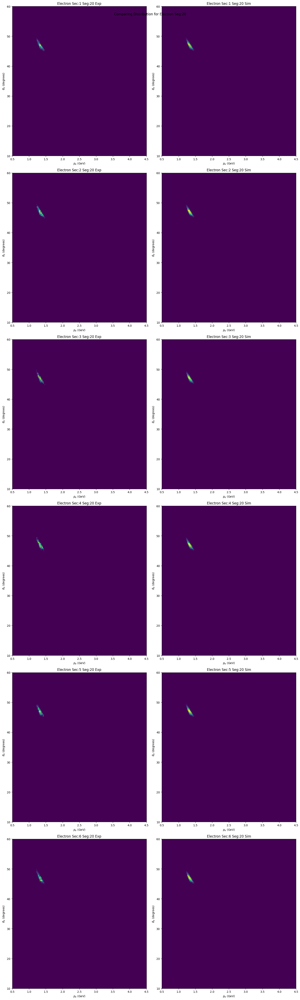

**Finished**
Electron Seg:20
**--------**
**Starting**
Electron Seg:21


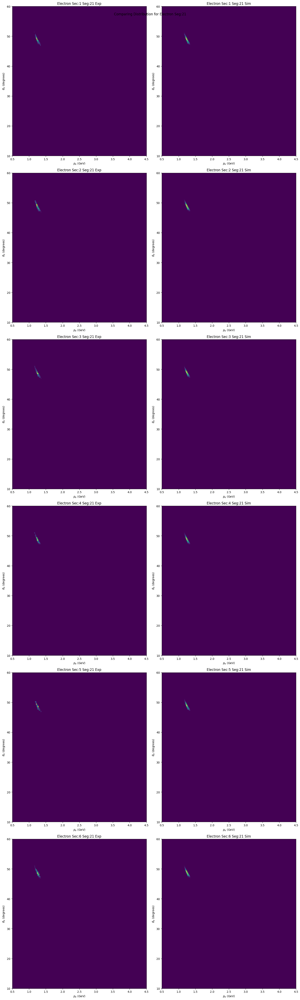

**Finished**
Electron Seg:21
**--------**
**Starting**
Electron Seg:22


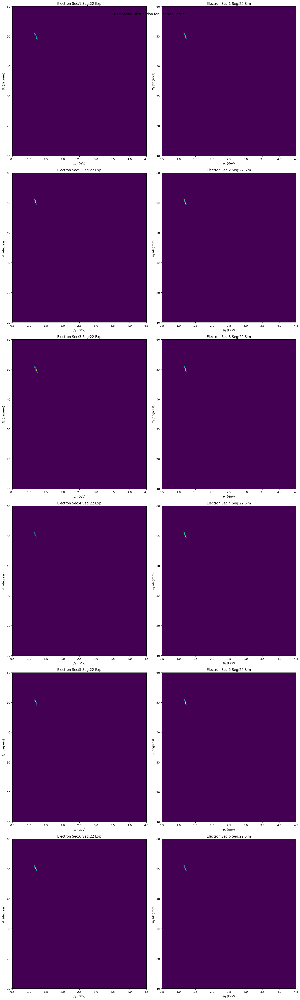

**Finished**
Electron Seg:22
**--------**
**Starting**
Electron Seg:23


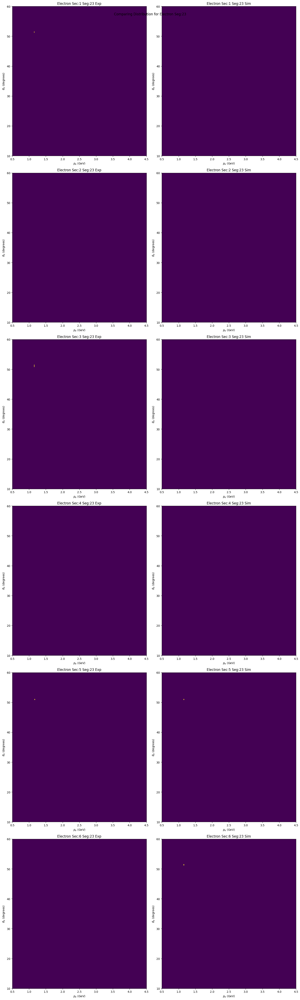

**Finished**
Electron Seg:23
**--------**
**Starting**
Electron Seg:24


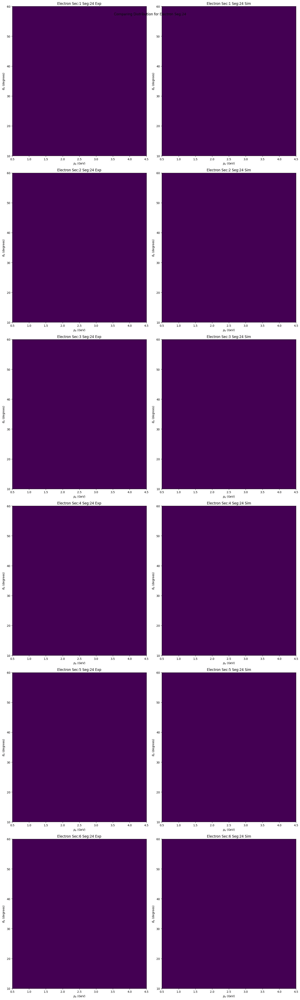

**Finished**
Electron Seg:24
**--------**
**Starting**
Electron Seg:25


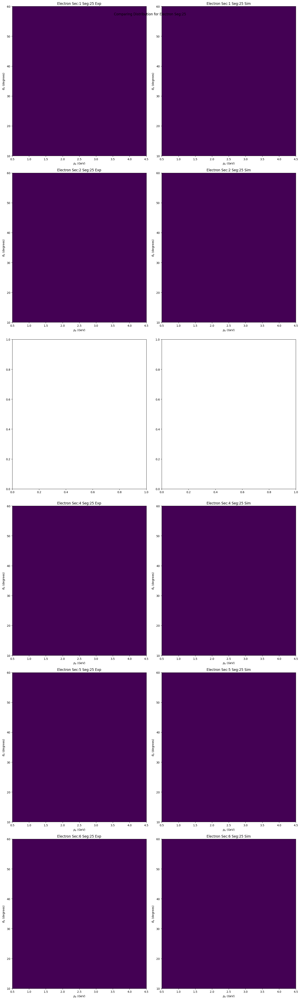

**Finished**
Electron Seg:25
**--------**
**Starting**
Electron Seg:26


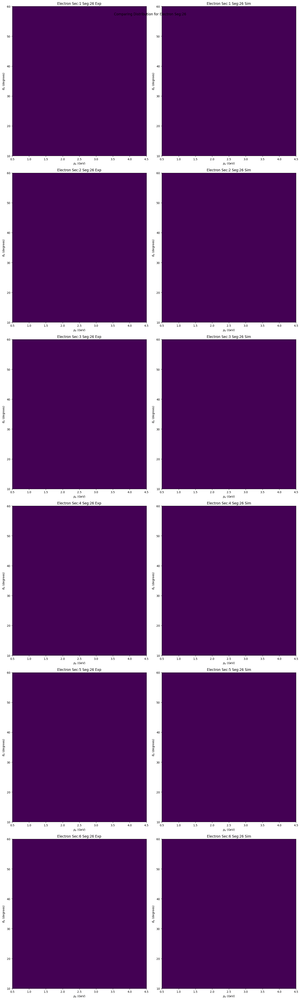

**Finished**
Electron Seg:26
**--------**
**Starting**
Electron Seg:27


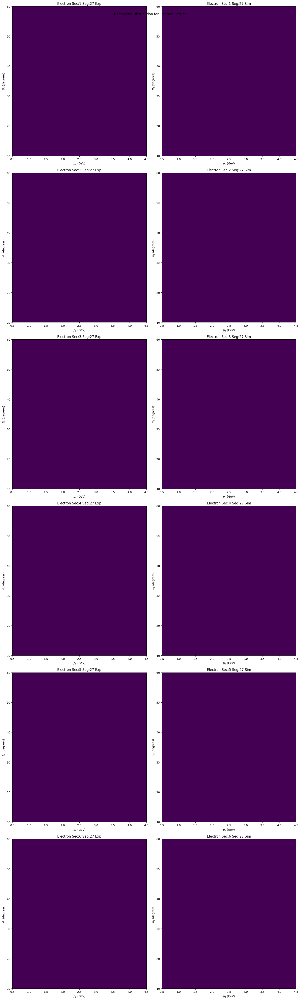

**Finished**
Electron Seg:27
**--------**
**Starting**
Electron Seg:28


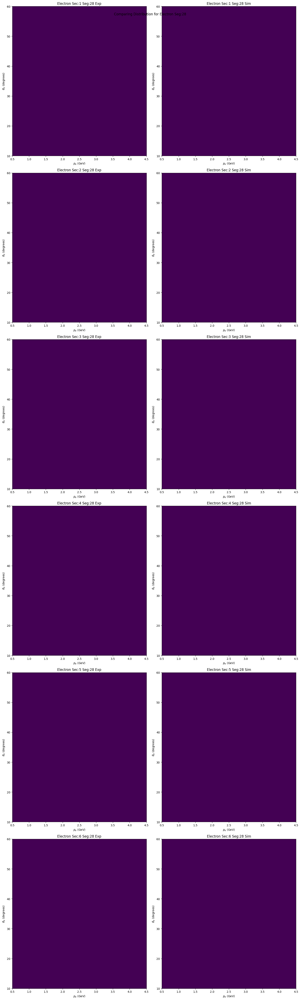

**Finished**
Electron Seg:28
**--------**
**Starting**
Electron Seg:29


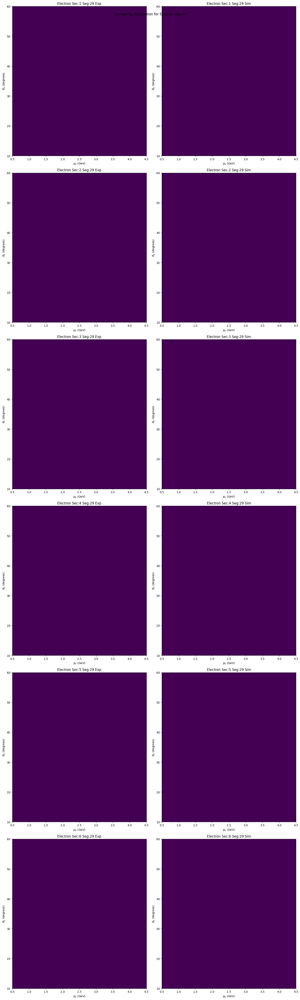

**Finished**
Electron Seg:29
**--------**
**Starting**
Electron Seg:30


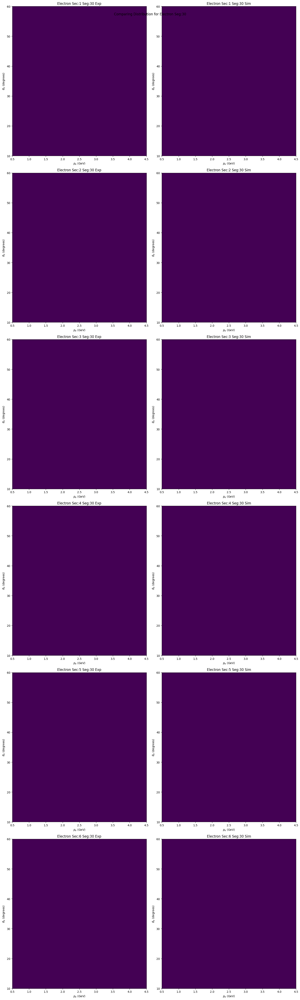

**Finished**
Electron Seg:30
**--------**
**Starting**
Electron Seg:31


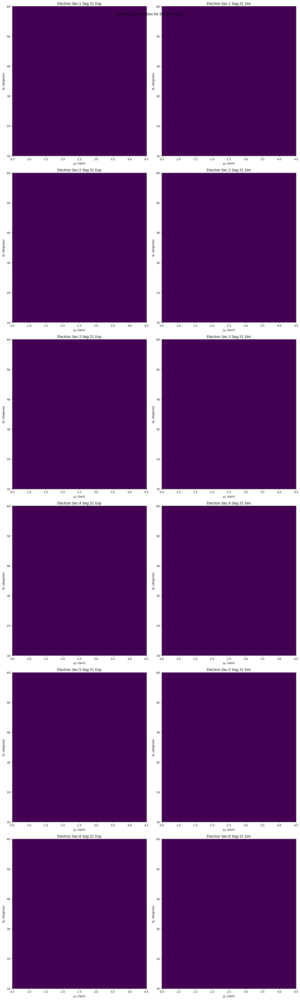

**Finished**
Electron Seg:31
**--------**
**Starting**
Electron Seg:32


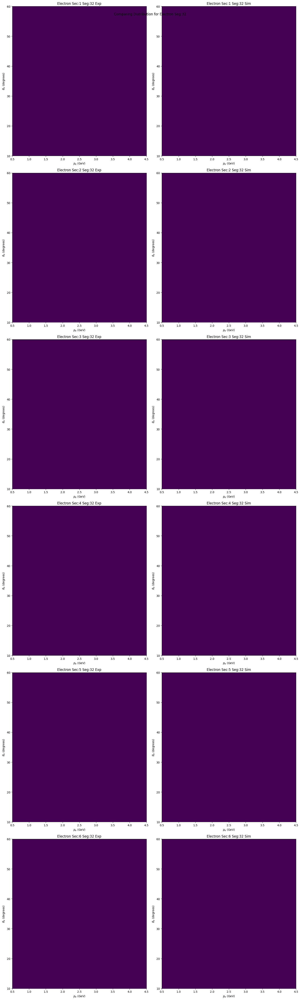

**Finished**
Electron Seg:32
**--------**
**Starting**
Electron Seg:33


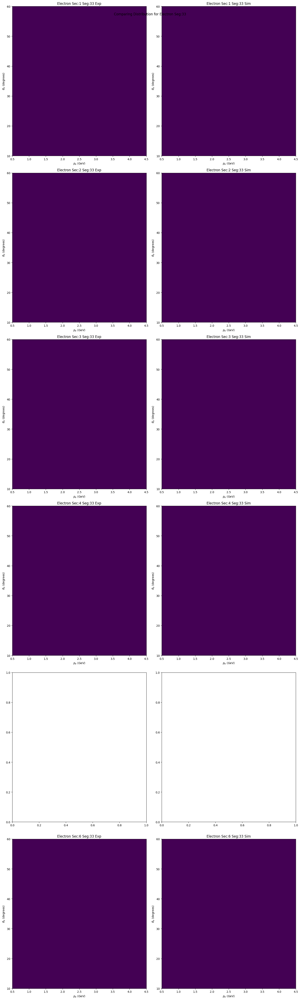

**Finished**
Electron Seg:33
**--------**
**Starting**
Electron Seg:34


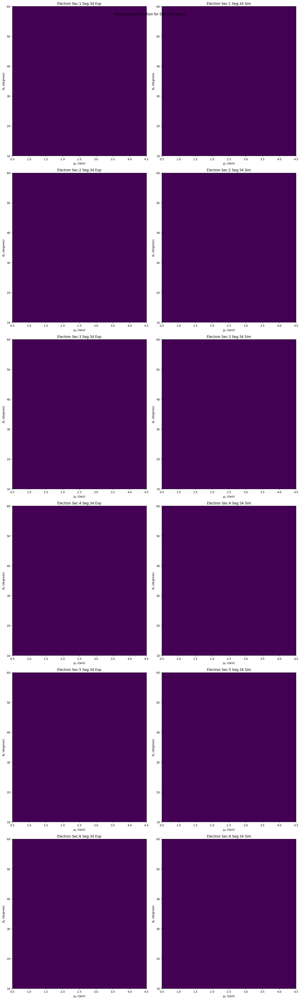

**Finished**
Electron Seg:34
**--------**
**Starting**
Electron Seg:35


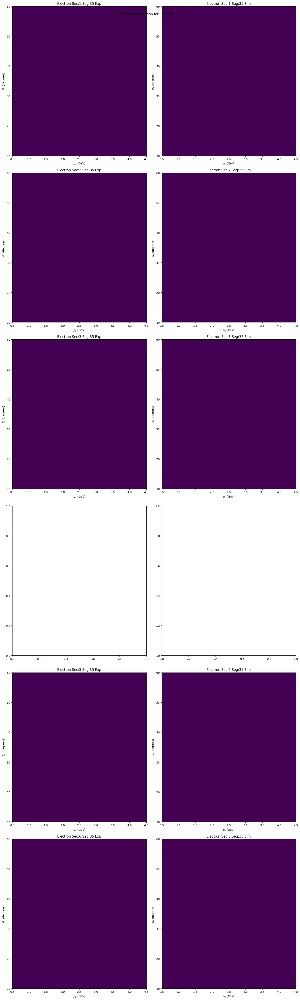

**Finished**
Electron Seg:35
**--------**
**Starting**
Electron Seg:36


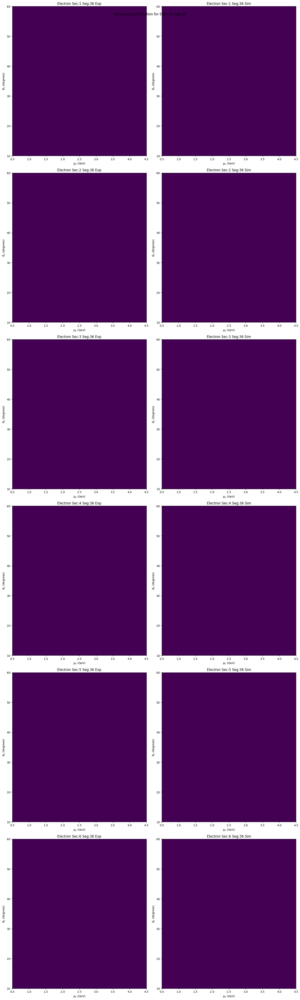

**Finished**
Electron Seg:36
**--------**
**Starting**
Electron Seg:37


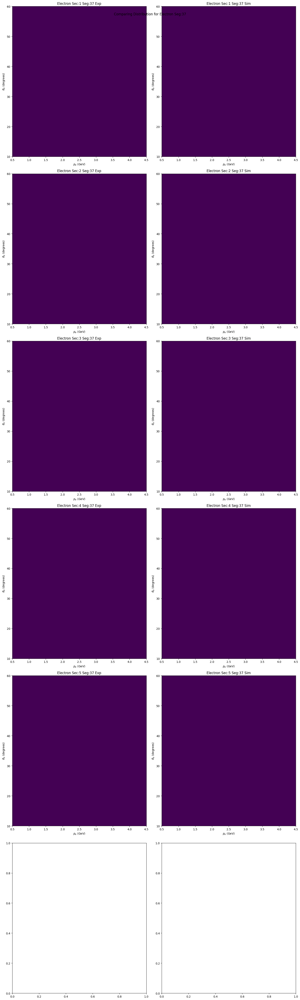

**Finished**
Electron Seg:37
**--------**
**Starting**
Electron Seg:38


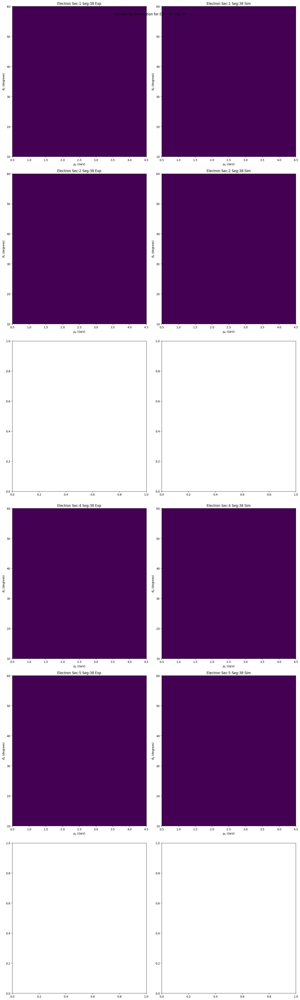

**Finished**
Electron Seg:38
**--------**
**Starting**
Electron Seg:39


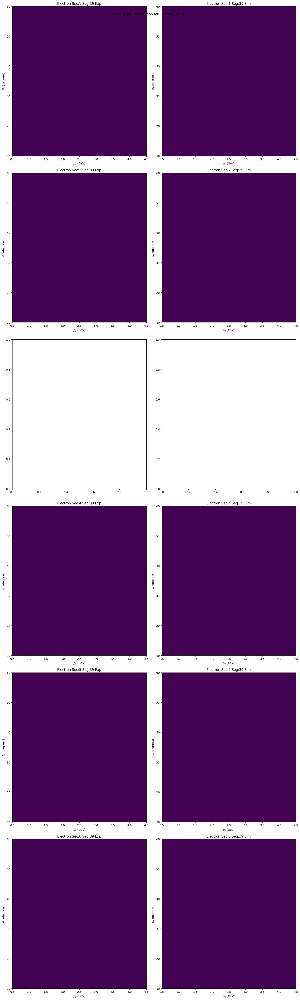

**Finished**
Electron Seg:39
**--------**
**Starting**
Electron Seg:40


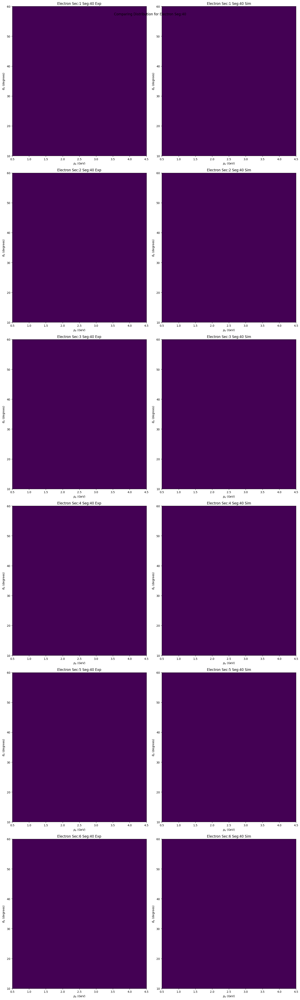

**Finished**
Electron Seg:40
**--------**
**Starting**
Electron Seg:41


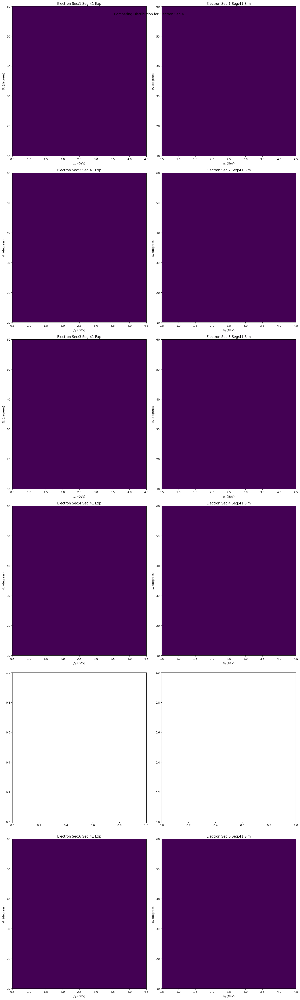

**Finished**
Electron Seg:41
**--------**
**Starting**
Electron Seg:42


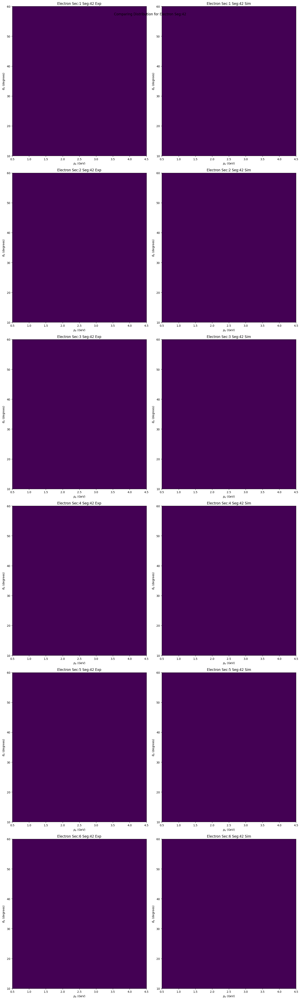

**Finished**
Electron Seg:42
**--------**
**Starting**
Electron Seg:43


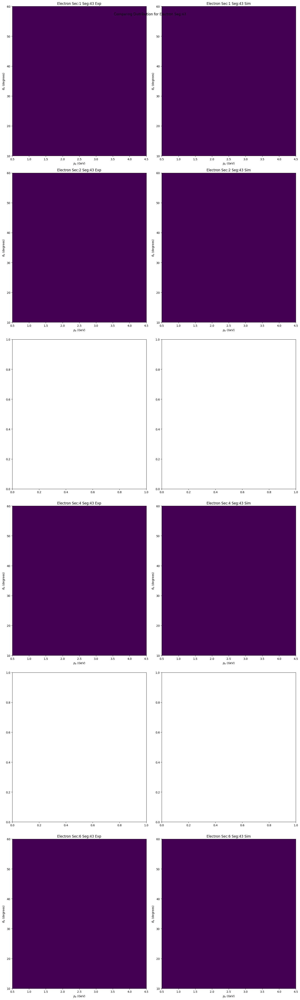

**Finished**
Electron Seg:43
**--------**
**Starting**
Electron Seg:44


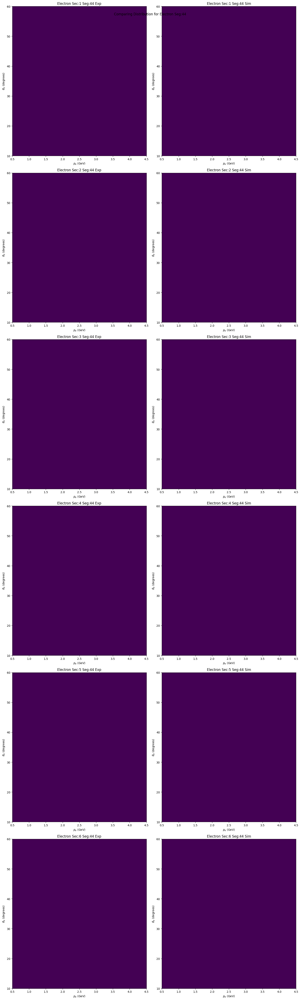

**Finished**
Electron Seg:44
**--------**
**Starting**
Electron Seg:45


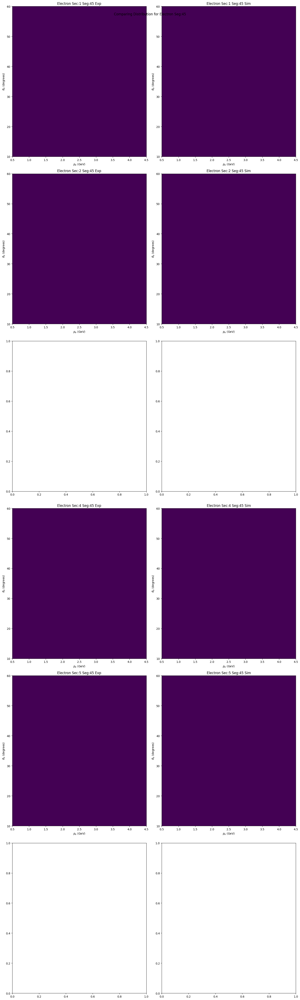

**Finished**
Electron Seg:45
**--------**
**Starting**
Electron Seg:46


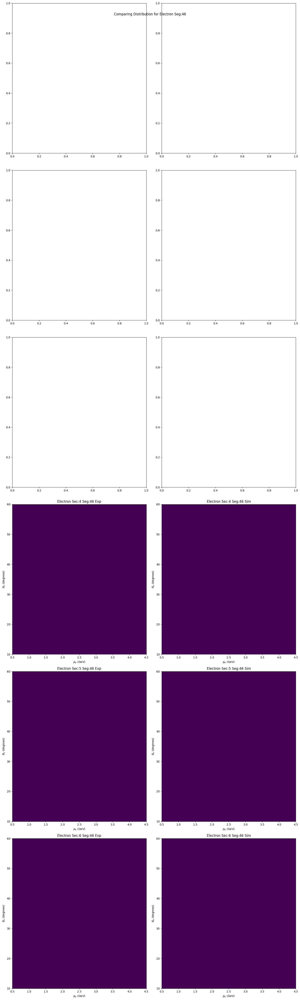

**Finished**
Electron Seg:46
**--------**
**Starting**
Electron Seg:47


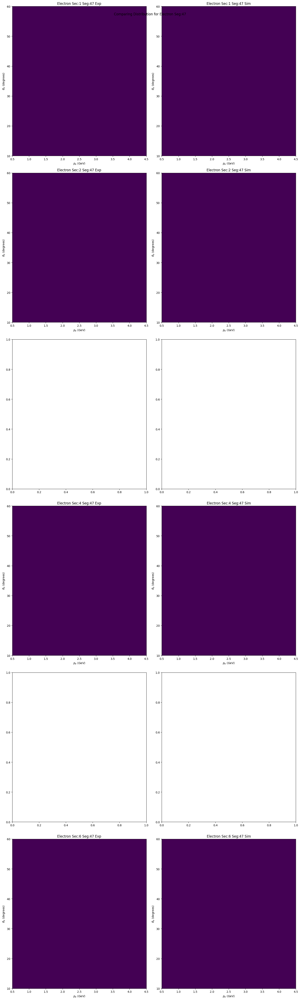

**Finished**
Electron Seg:47
**--------**
**Starting**
Electron Seg:48


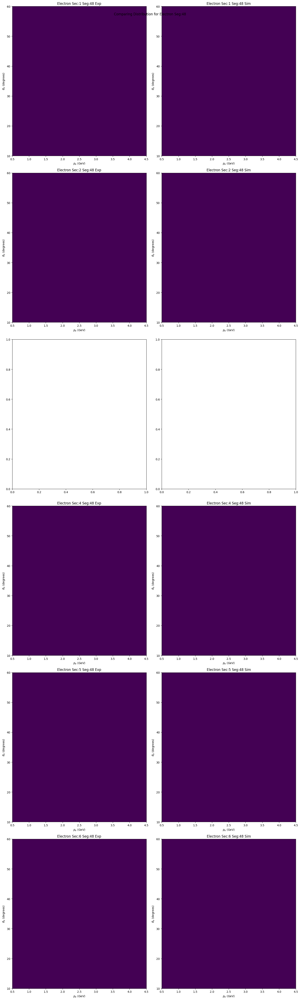

**Finished**
Electron Seg:48
**--------**
**Starting**
Proton Seg:1


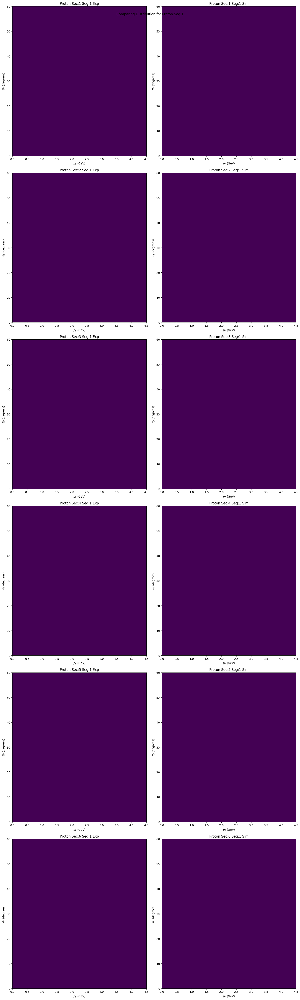

**Finished**
Proton Seg:1
**--------**
**Starting**
Proton Seg:2


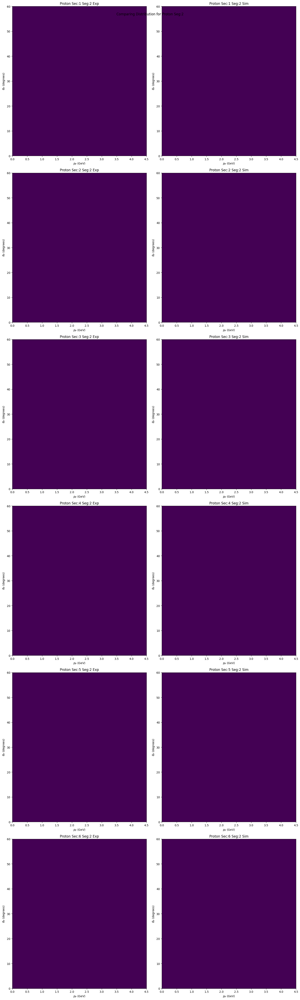

**Finished**
Proton Seg:2
**--------**
**Starting**
Proton Seg:3


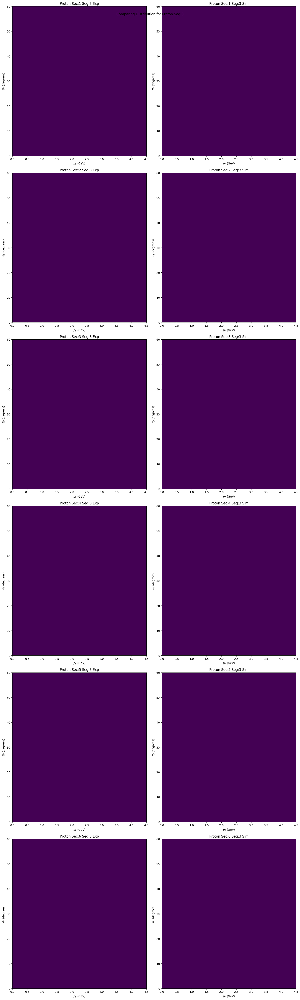

**Finished**
Proton Seg:3
**--------**
**Starting**
Proton Seg:4


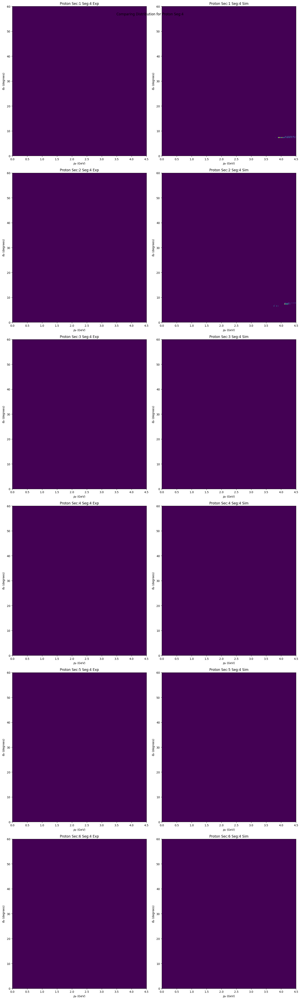

**Finished**
Proton Seg:4
**--------**
**Starting**
Proton Seg:5


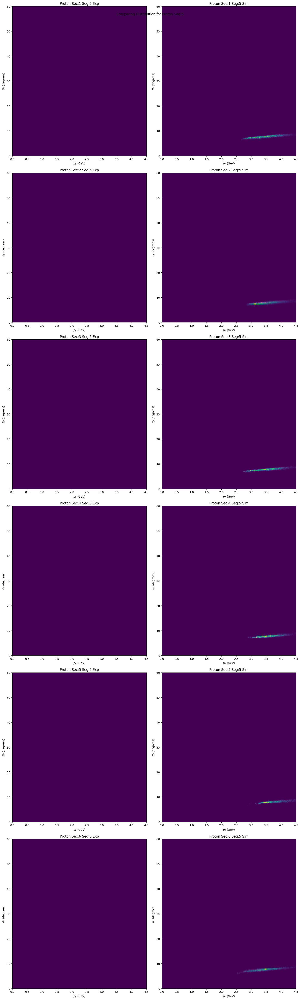

**Finished**
Proton Seg:5
**--------**
**Starting**
Proton Seg:6


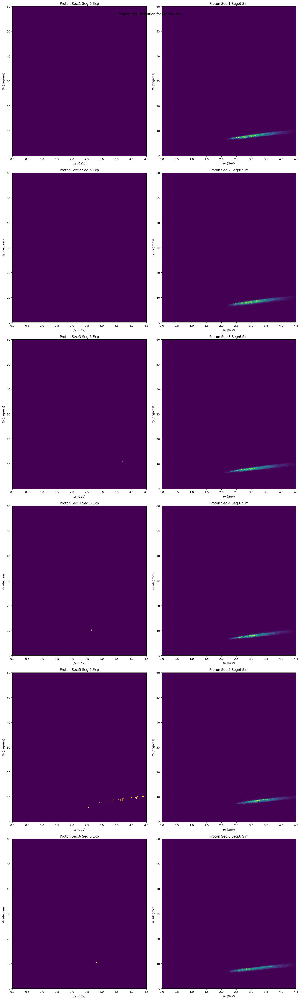

**Finished**
Proton Seg:6
**--------**
**Starting**
Proton Seg:7


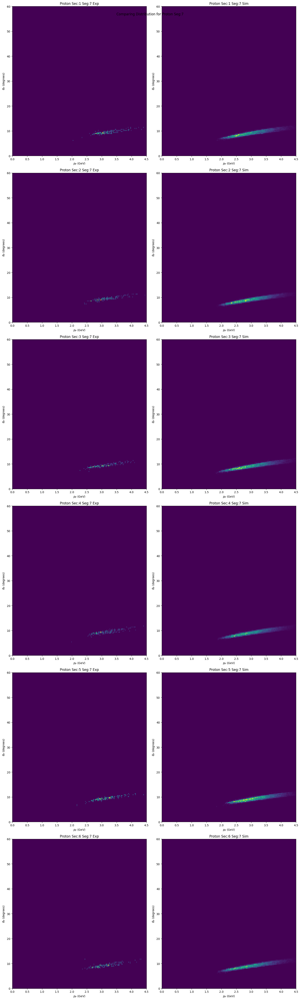

**Finished**
Proton Seg:7
**--------**
**Starting**
Proton Seg:8


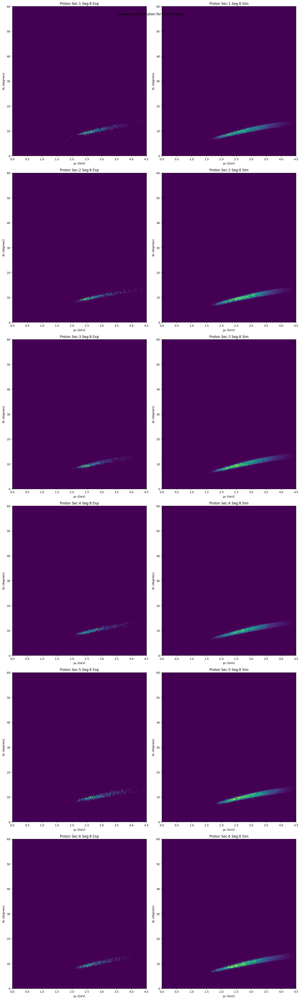

**Finished**
Proton Seg:8
**--------**
**Starting**
Proton Seg:9


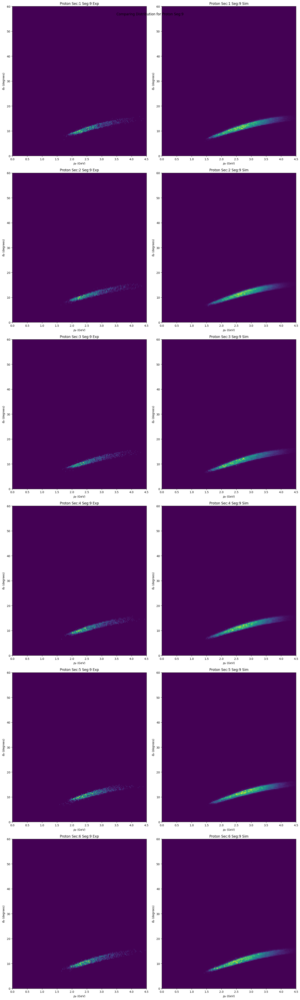

**Finished**
Proton Seg:9
**--------**
**Starting**
Proton Seg:10


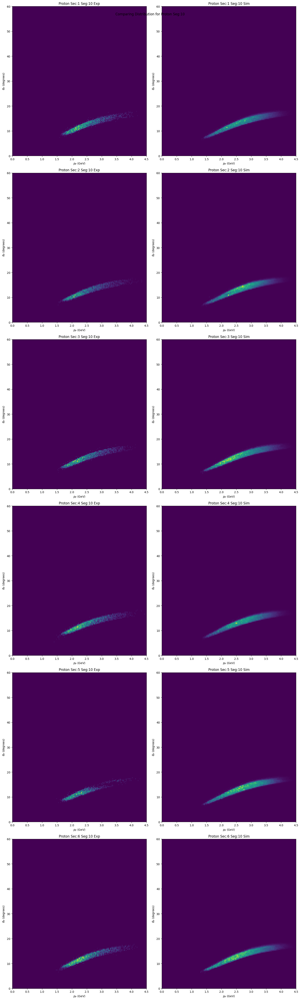

**Finished**
Proton Seg:10
**--------**
**Starting**
Proton Seg:11


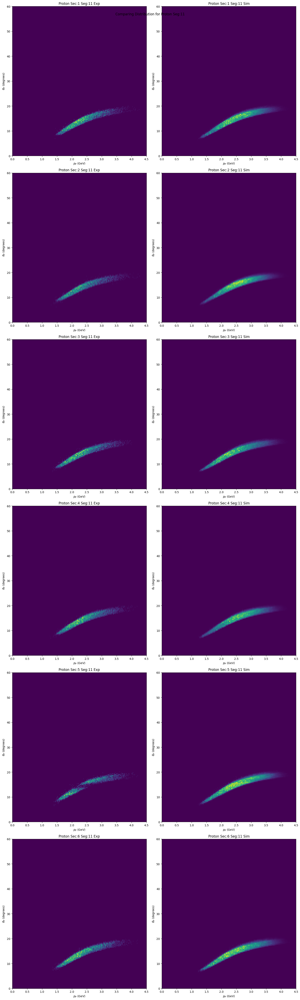

**Finished**
Proton Seg:11
**--------**
**Starting**
Proton Seg:12


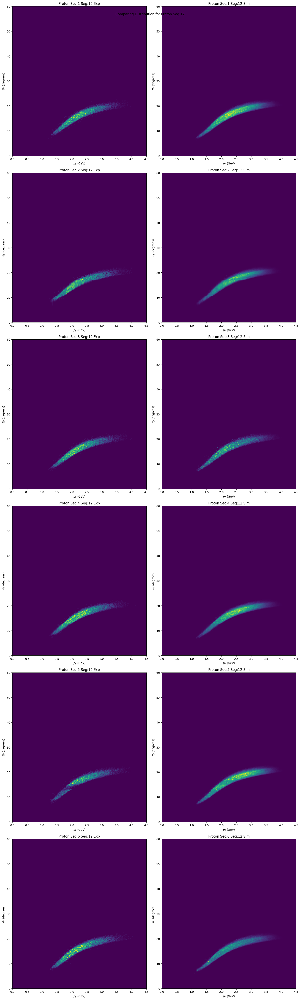

**Finished**
Proton Seg:12
**--------**
**Starting**
Proton Seg:13


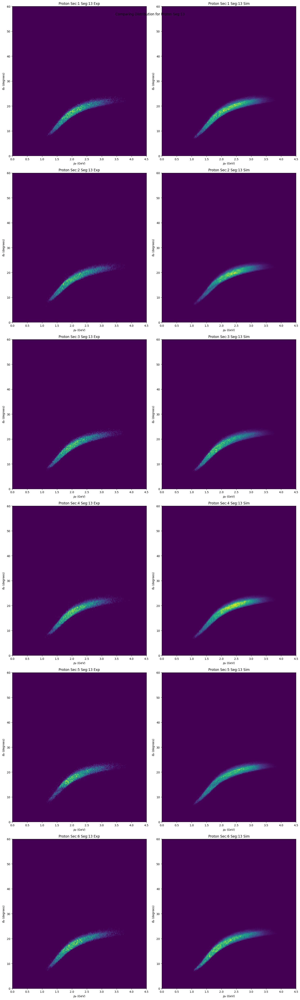

**Finished**
Proton Seg:13
**--------**
**Starting**
Proton Seg:14


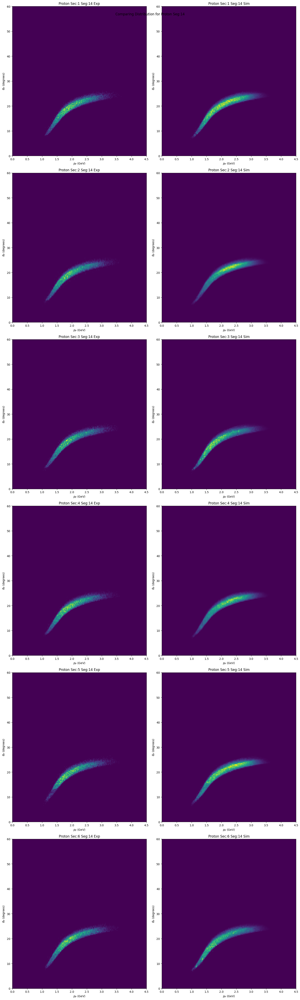

**Finished**
Proton Seg:14
**--------**
**Starting**
Proton Seg:15


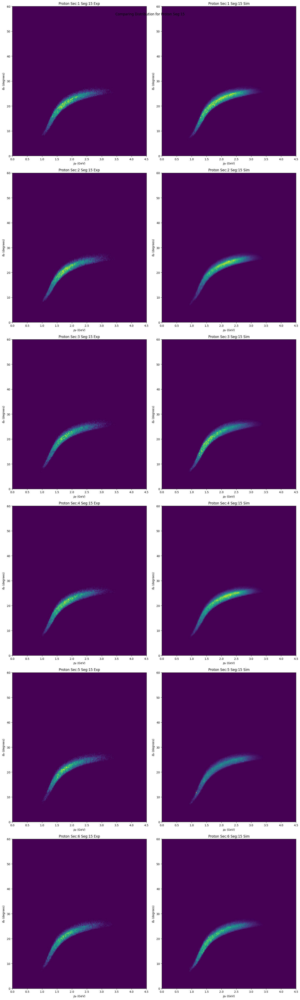

**Finished**
Proton Seg:15
**--------**
**Starting**
Proton Seg:16


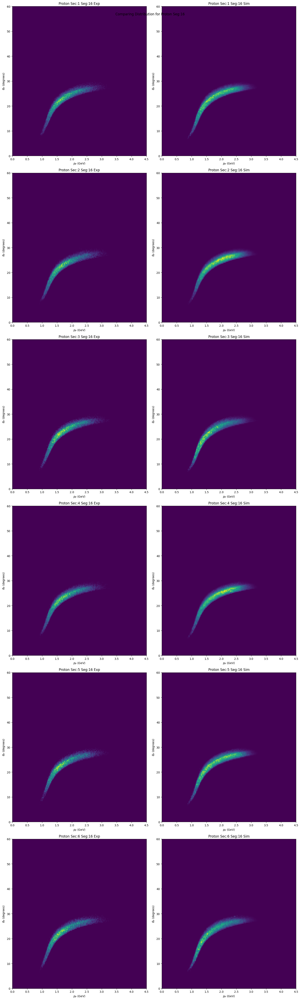

**Finished**
Proton Seg:16
**--------**
**Starting**
Proton Seg:17


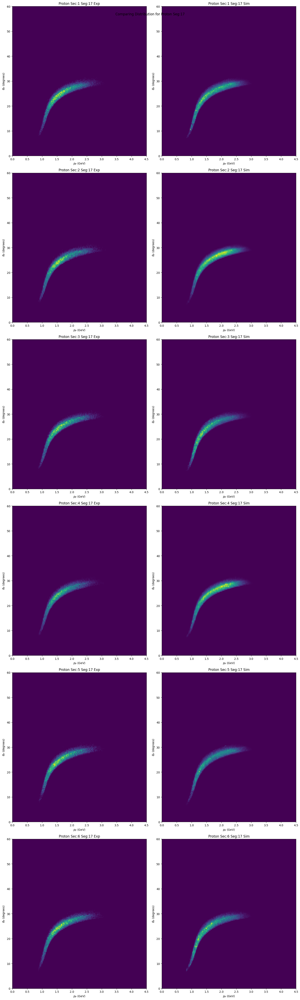

**Finished**
Proton Seg:17
**--------**
**Starting**
Proton Seg:18


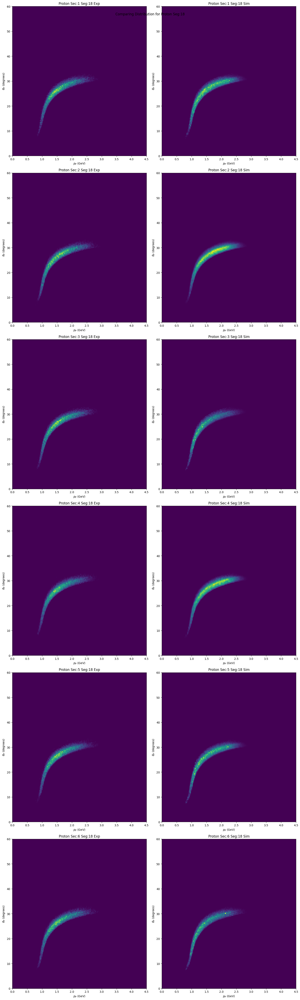

**Finished**
Proton Seg:18
**--------**
**Starting**
Proton Seg:19


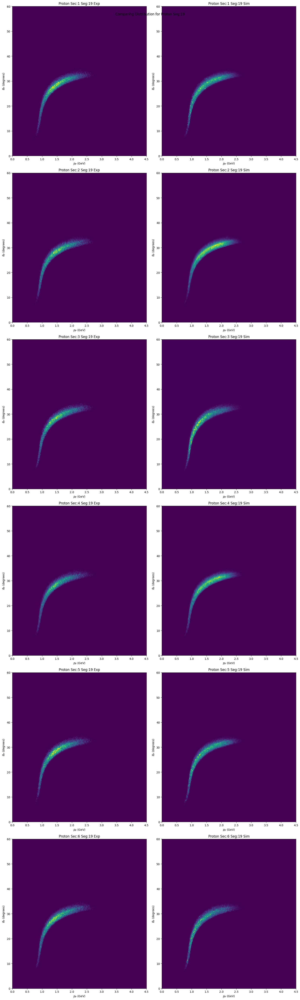

**Finished**
Proton Seg:19
**--------**
**Starting**
Proton Seg:20


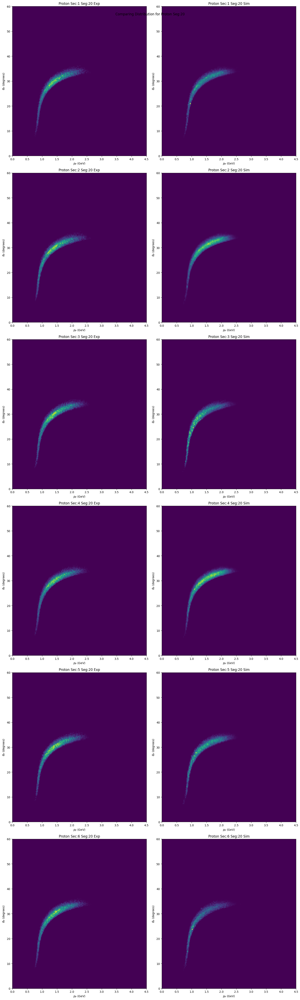

**Finished**
Proton Seg:20
**--------**
**Starting**
Proton Seg:21


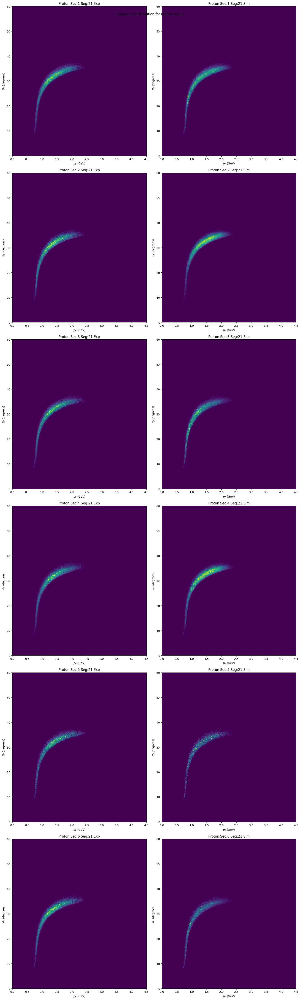

**Finished**
Proton Seg:21
**--------**
**Starting**
Proton Seg:22


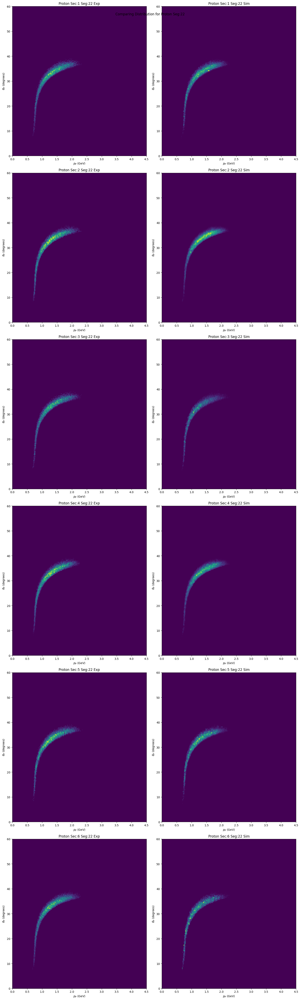

**Finished**
Proton Seg:22
**--------**
**Starting**
Proton Seg:23


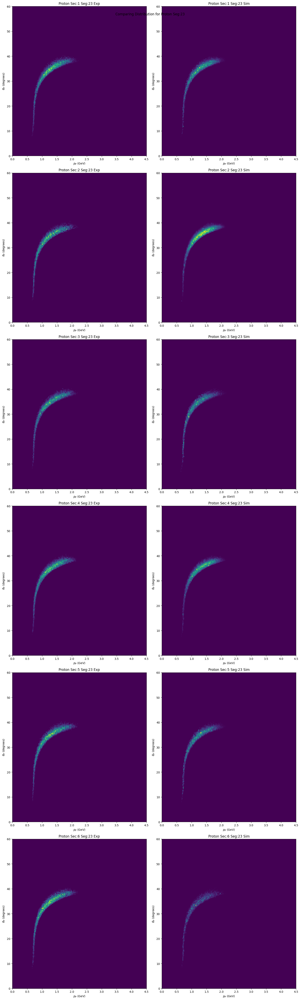

**Finished**
Proton Seg:23
**--------**
**Starting**
Proton Seg:24


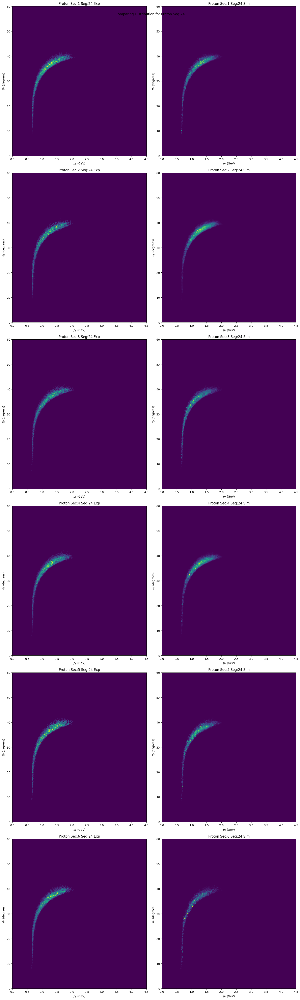

**Finished**
Proton Seg:24
**--------**
**Starting**
Proton Seg:25


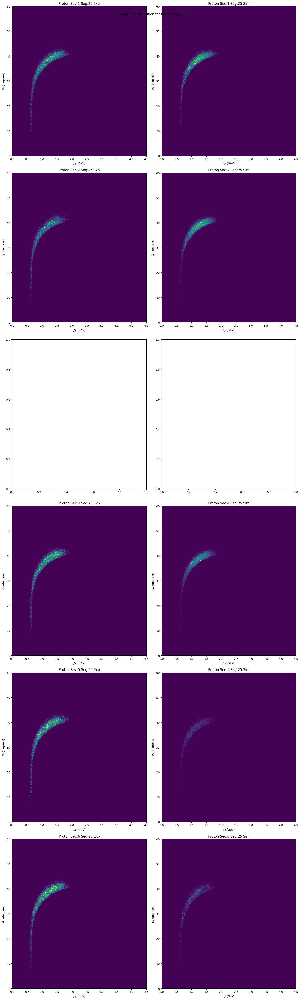

**Finished**
Proton Seg:25
**--------**
**Starting**
Proton Seg:26


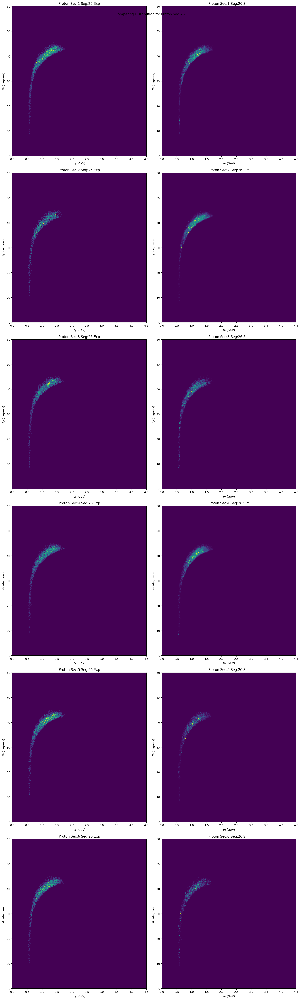

**Finished**
Proton Seg:26
**--------**
**Starting**
Proton Seg:27


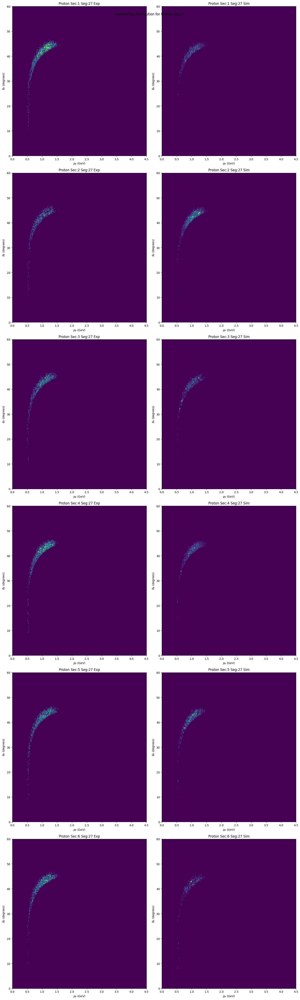

**Finished**
Proton Seg:27
**--------**
**Starting**
Proton Seg:28


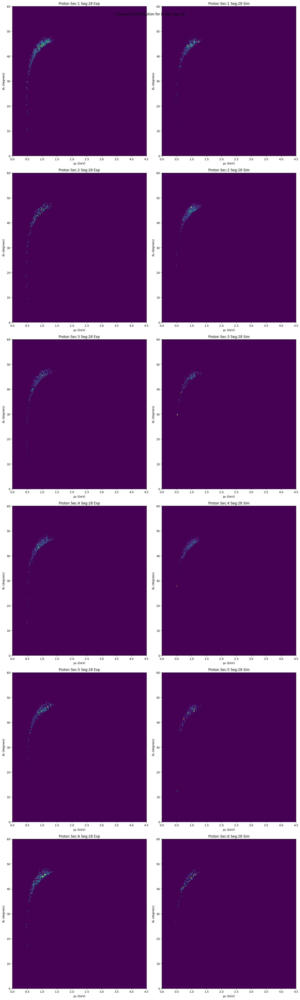

**Finished**
Proton Seg:28
**--------**
**Starting**
Proton Seg:29


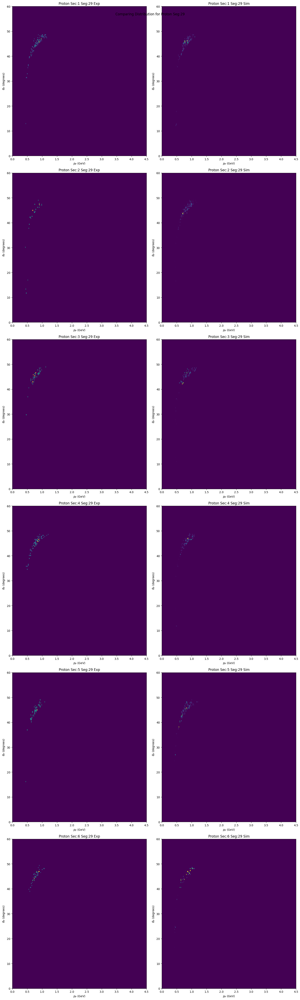

**Finished**
Proton Seg:29
**--------**
**Starting**
Proton Seg:30


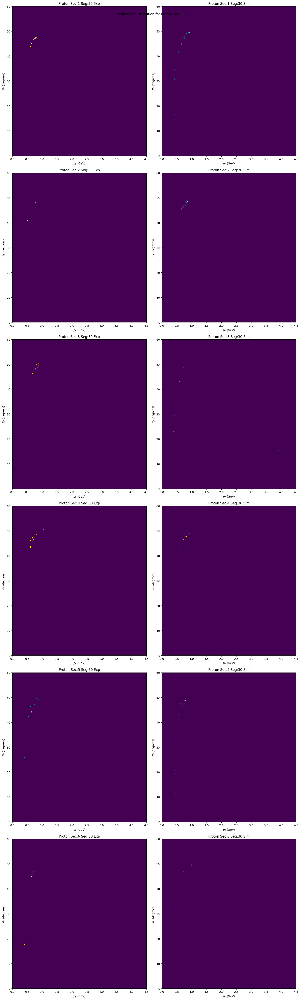

**Finished**
Proton Seg:30
**--------**
**Starting**
Proton Seg:31


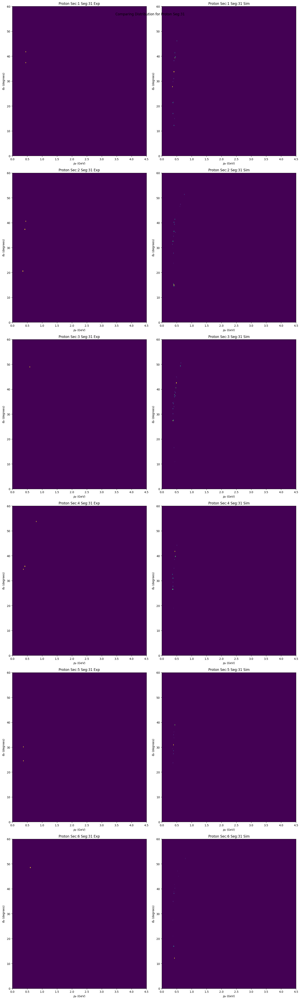

**Finished**
Proton Seg:31
**--------**
**Starting**
Proton Seg:32


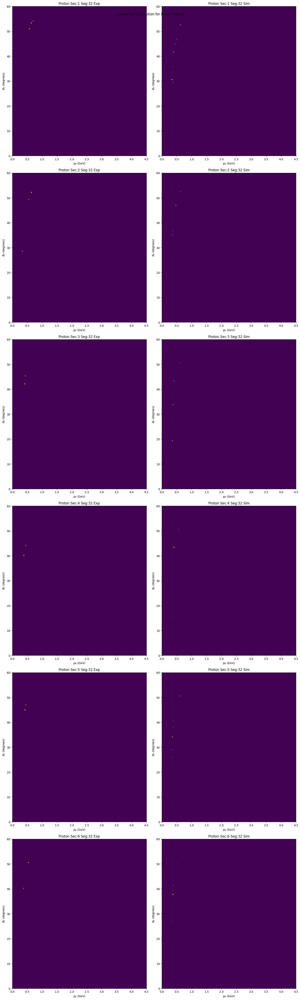

**Finished**
Proton Seg:32
**--------**
**Starting**
Proton Seg:33


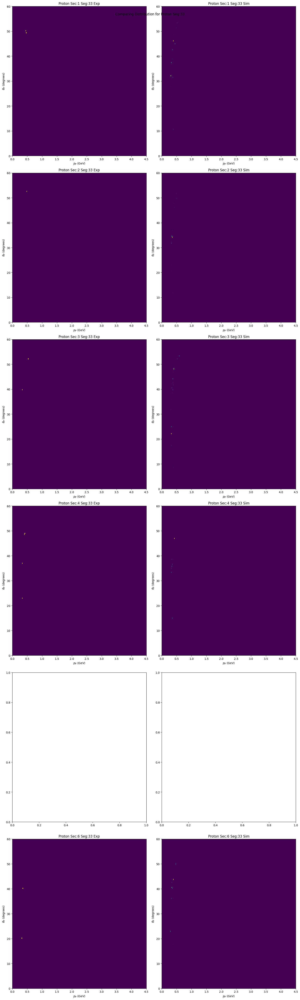

**Finished**
Proton Seg:33
**--------**
**Starting**
Proton Seg:34


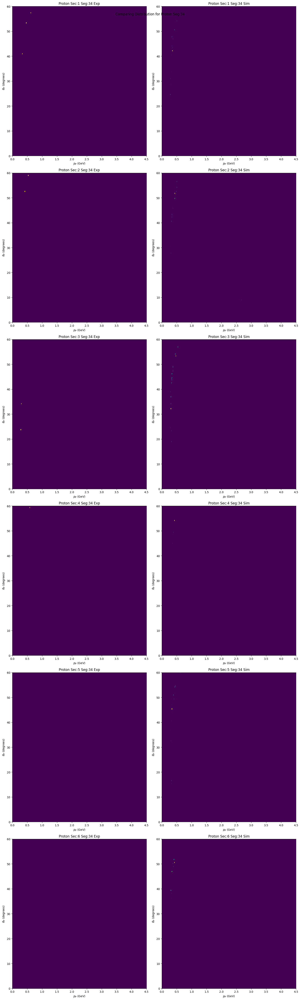

**Finished**
Proton Seg:34
**--------**
**Starting**
Proton Seg:35


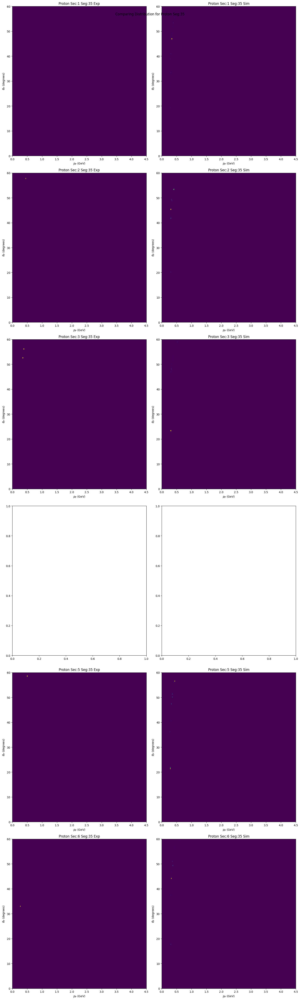

**Finished**
Proton Seg:35
**--------**
**Starting**
Proton Seg:36


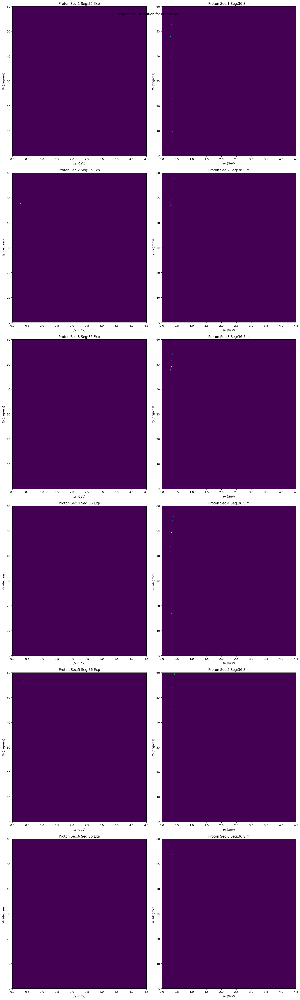

**Finished**
Proton Seg:36
**--------**
**Starting**
Proton Seg:37


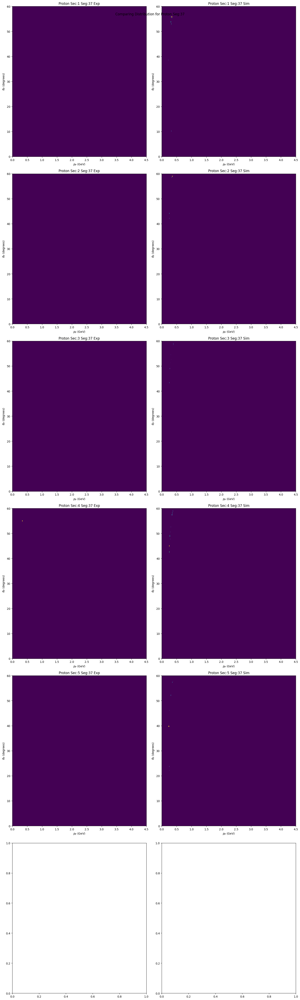

**Finished**
Proton Seg:37
**--------**
**Starting**
Proton Seg:38


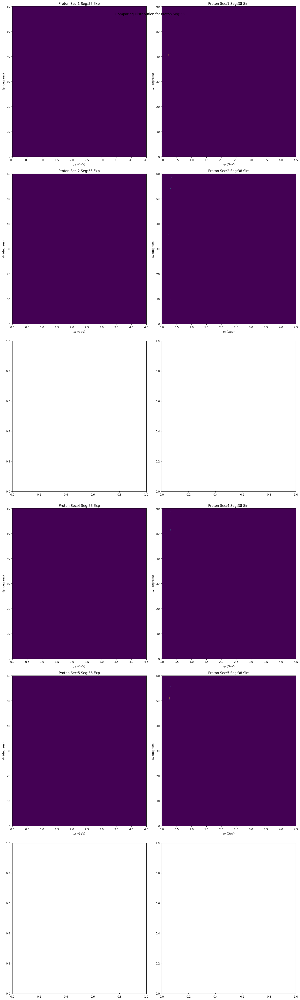

**Finished**
Proton Seg:38
**--------**
**Starting**
Proton Seg:39


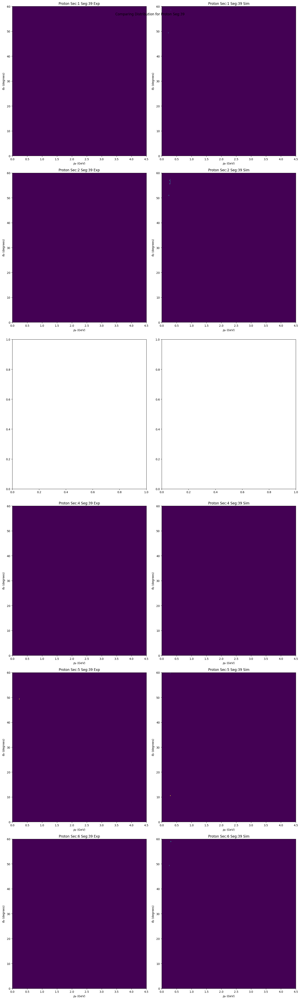

**Finished**
Proton Seg:39
**--------**
**Starting**
Proton Seg:40


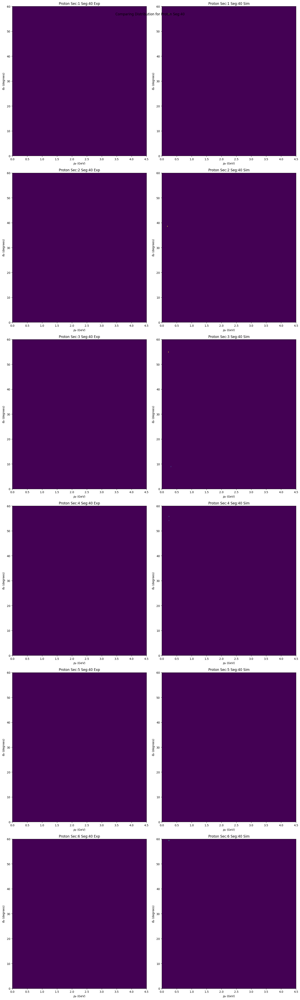

**Finished**
Proton Seg:40
**--------**
**Starting**
Proton Seg:41


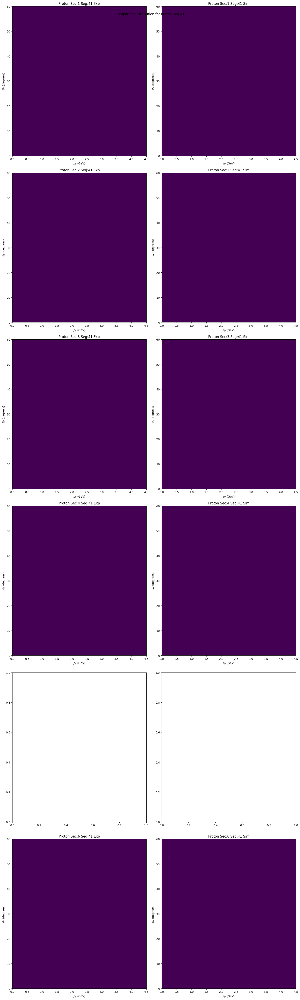

**Finished**
Proton Seg:41
**--------**
**Starting**
Proton Seg:42


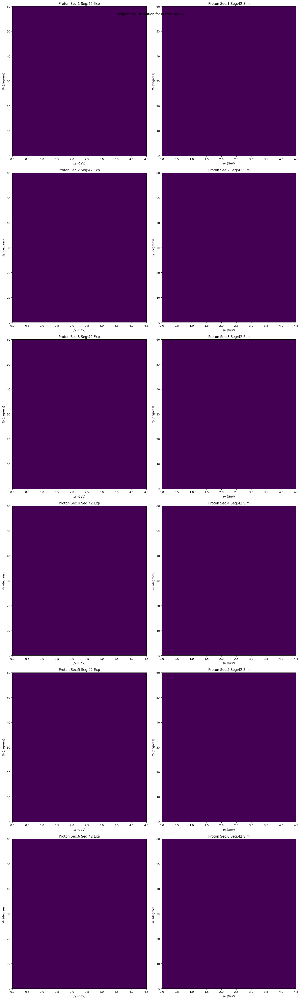

**Finished**
Proton Seg:42
**--------**
**Starting**
Proton Seg:43


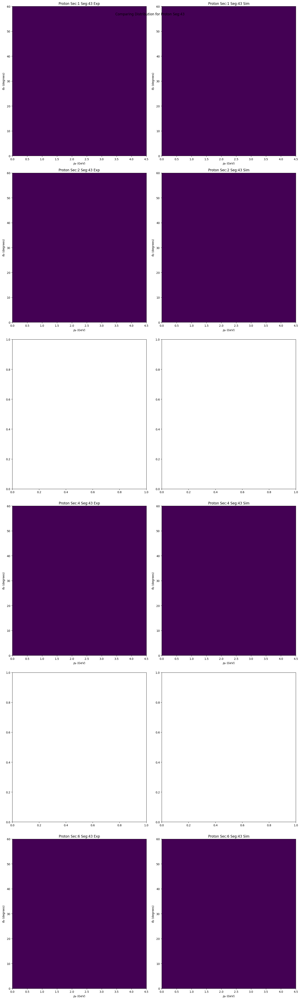

**Finished**
Proton Seg:43
**--------**
**Starting**
Proton Seg:44


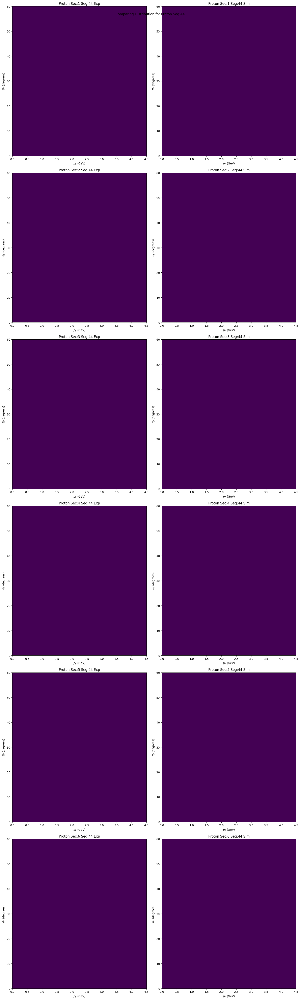

**Finished**
Proton Seg:44
**--------**
**Starting**
Proton Seg:45


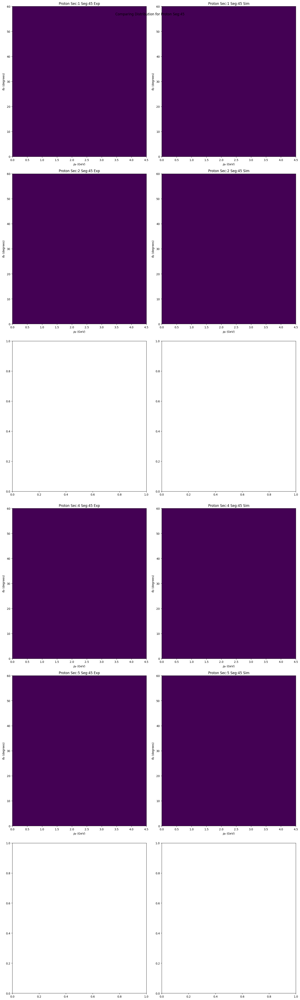

**Finished**
Proton Seg:45
**--------**
**Starting**
Proton Seg:46


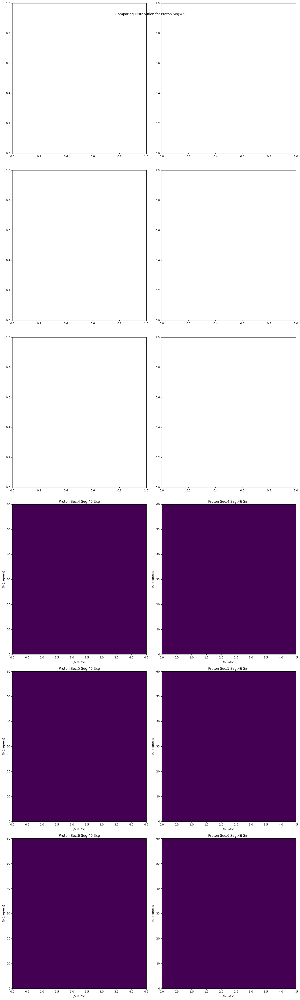

**Finished**
Proton Seg:46
**--------**
**Starting**
Proton Seg:47


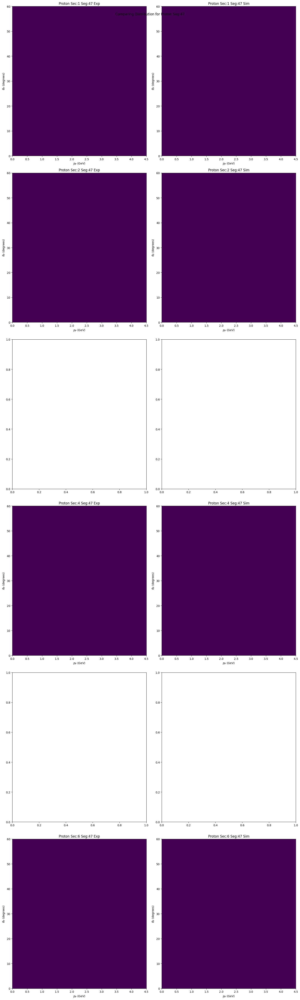

**Finished**
Proton Seg:47
**--------**
**Starting**
Proton Seg:48


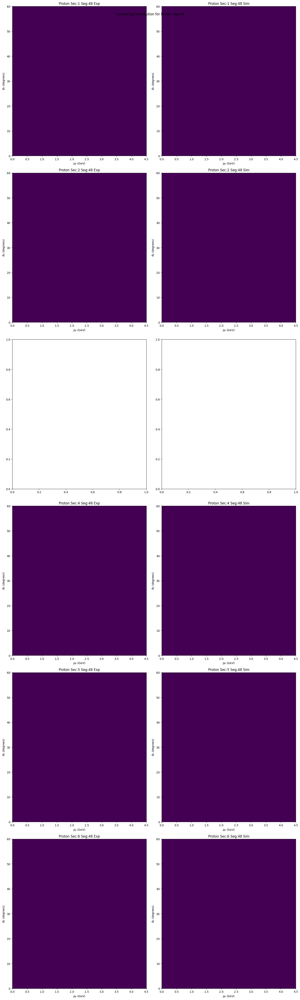

**Finished**
Proton Seg:48
**--------**
**Starting**
$π^+$ Seg:1


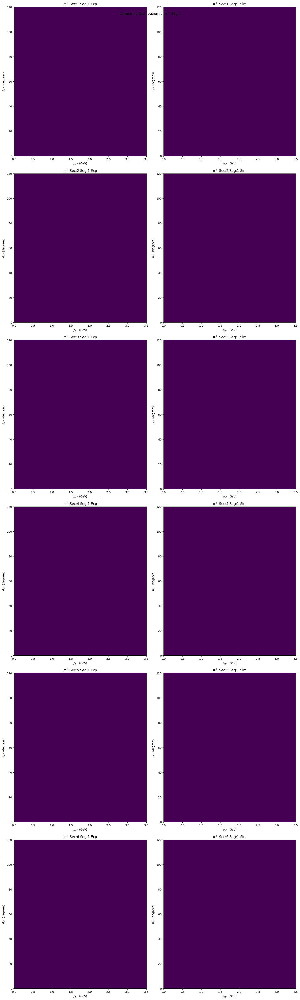

**Finished**
$π^+$ Seg:1
**--------**
**Starting**
$π^+$ Seg:2


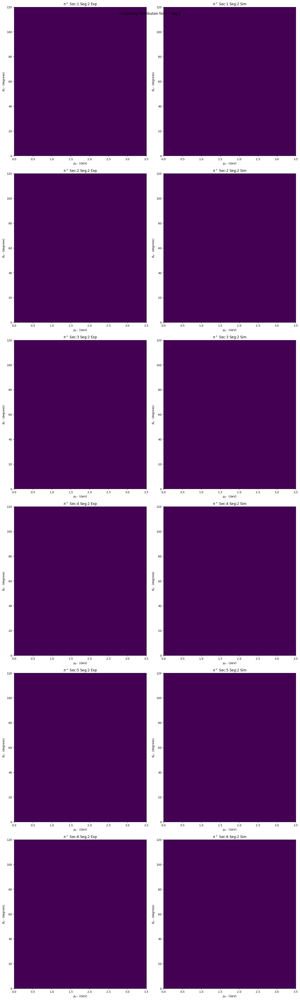

**Finished**
$π^+$ Seg:2
**--------**
**Starting**
$π^+$ Seg:3


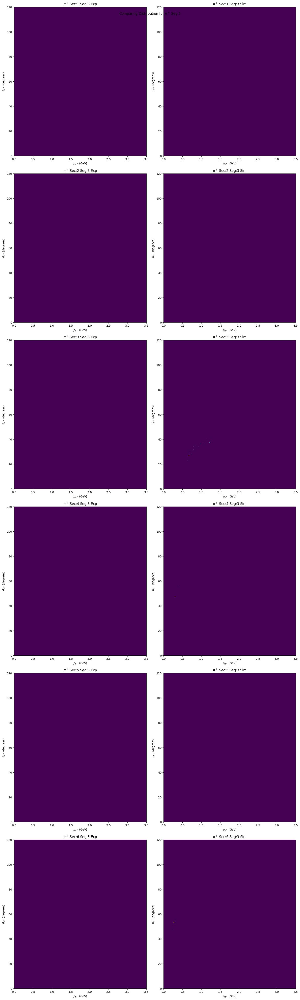

**Finished**
$π^+$ Seg:3
**--------**
**Starting**
$π^+$ Seg:4


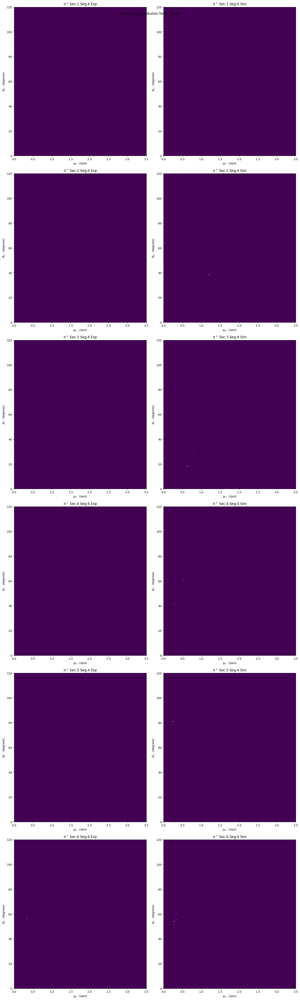

**Finished**
$π^+$ Seg:4
**--------**
**Starting**
$π^+$ Seg:5


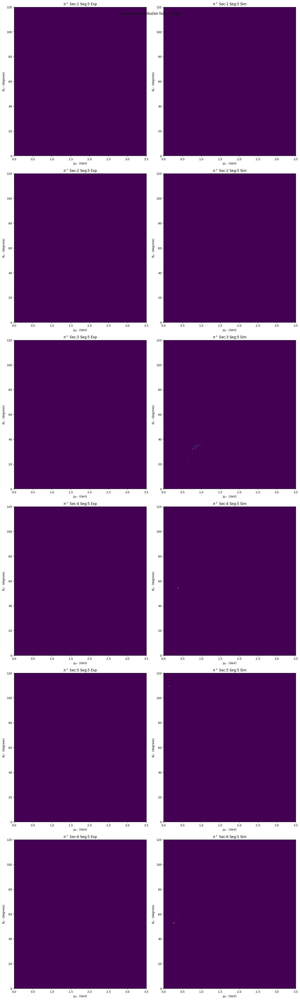

**Finished**
$π^+$ Seg:5
**--------**
**Starting**
$π^+$ Seg:6


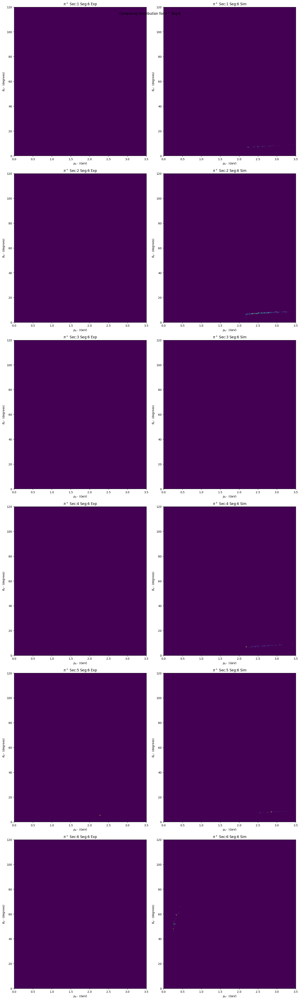

**Finished**
$π^+$ Seg:6
**--------**
**Starting**
$π^+$ Seg:7


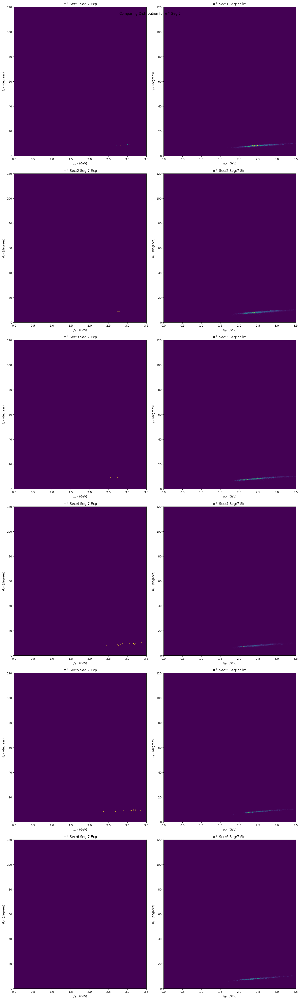

**Finished**
$π^+$ Seg:7
**--------**
**Starting**
$π^+$ Seg:8


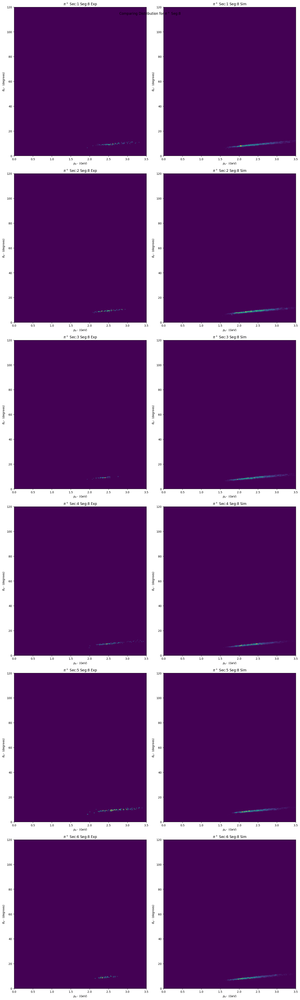

**Finished**
$π^+$ Seg:8
**--------**
**Starting**
$π^+$ Seg:9


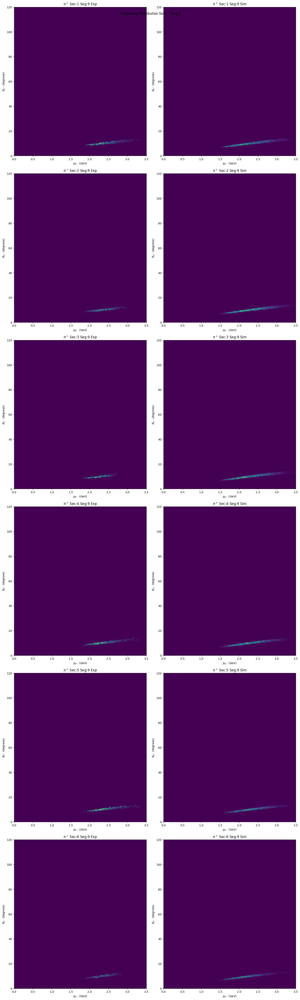

**Finished**
$π^+$ Seg:9
**--------**
**Starting**
$π^+$ Seg:10


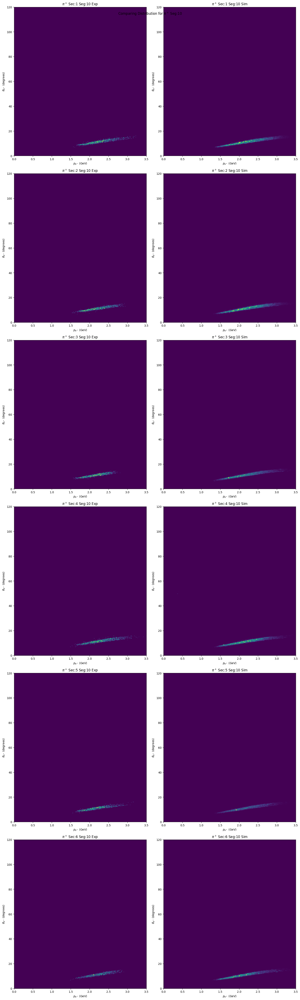

**Finished**
$π^+$ Seg:10
**--------**
**Starting**
$π^+$ Seg:11


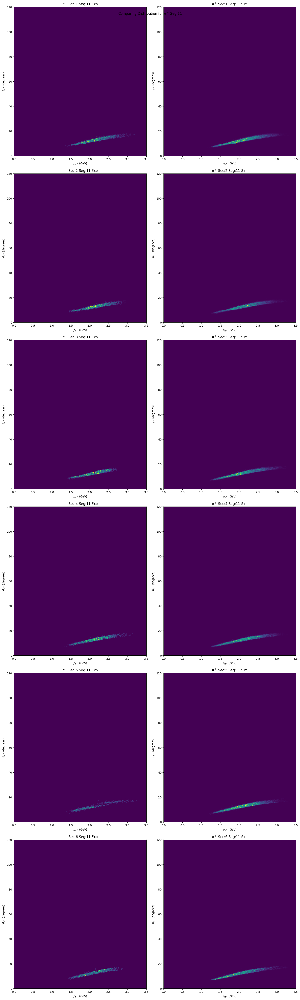

**Finished**
$π^+$ Seg:11
**--------**
**Starting**
$π^+$ Seg:12


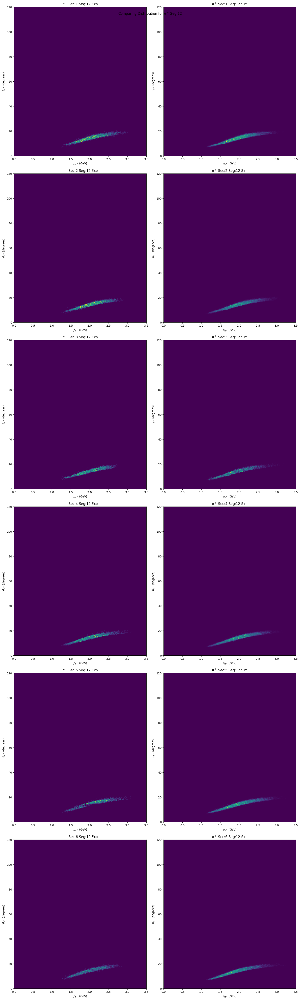

**Finished**
$π^+$ Seg:12
**--------**
**Starting**
$π^+$ Seg:13


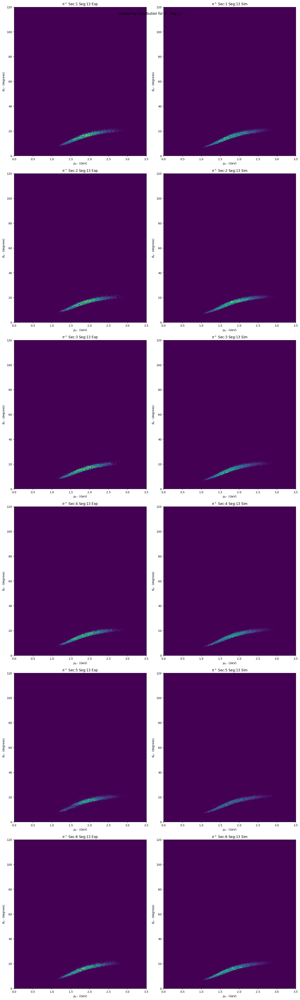

**Finished**
$π^+$ Seg:13
**--------**
**Starting**
$π^+$ Seg:14


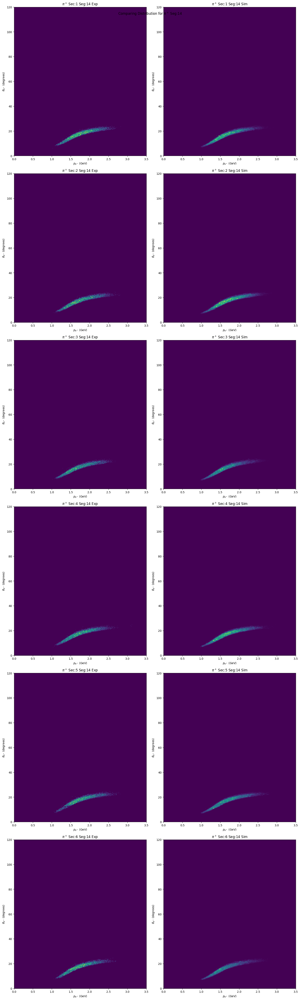

**Finished**
$π^+$ Seg:14
**--------**
**Starting**
$π^+$ Seg:15


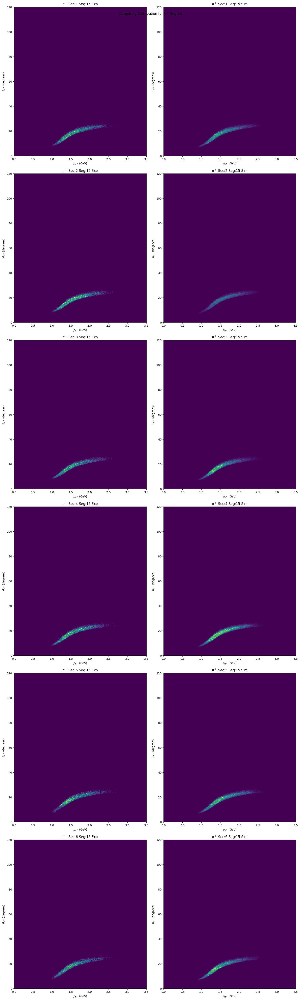

**Finished**
$π^+$ Seg:15
**--------**
**Starting**
$π^+$ Seg:16


KeyboardInterrupt: 

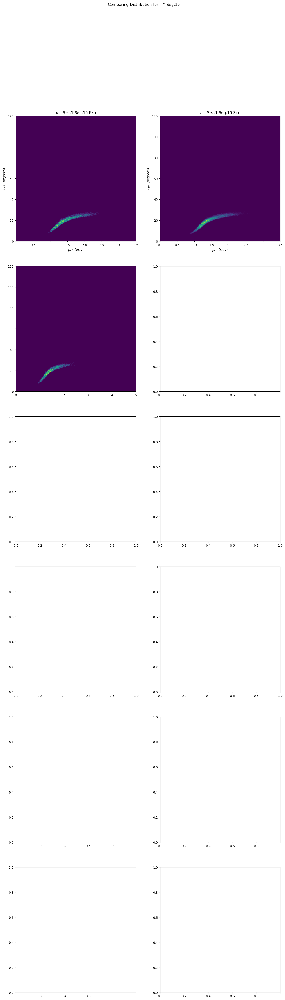

In [17]:
for par in range(4):
    for seg in range(48):
        if no_sc_seg[0][seg] == 1 or no_sc_seg[1][seg] == 1 or no_sc_seg[2][seg] == 1 or no_sc_seg[3][seg] == 1 or no_sc_seg[4][seg] == 1 or no_sc_seg[5][seg] == 1:
            figure, axis = plt.subplots(6,2)
            figure.set_size_inches(15,50)
            figure.suptitle("Comparing Distribution for {} Seg:{}".format(Particle[par],seg+1))
            print("**Starting**")
            print("{} Seg:{}".format(Particle[par],seg+1))
            for sec in range(6):
                if no_sc_seg[sec][seg] == 1:
                    axis[sec][0].pcolor(x,y,exp_z2_yx[par][sec][seg])
                    axis[sec][1].pcolor(x,y,sim_z2_yx[par][sec][seg])
                    axis[sec][0].set_xlabel(xname[par])
                    axis[sec][1].set_xlabel(xname[par])
                    axis[sec][0].set_ylabel(yname[par])
                    axis[sec][1].set_ylabel(yname[par])
                    axis[sec][0].set_title("{} Sec:{} Seg:{} Exp".format(Particle[par],sec+1,seg+1))
                    axis[sec][1].set_title("{} Sec:{} Seg:{} Sim".format(Particle[par],sec+1,seg+1))
                    axis[sec][0].set_xlim(xlims[par])
                    axis[sec][1].set_xlim(xlims[par])
                    axis[sec][0].set_ylim(ylims[par])
                    axis[sec][1].set_ylim(ylims[par])

            plt.tight_layout()    
            plt.show()
            print("**Finished**")
            print("{} Seg:{}".format(Particle[par],seg+1))
            print("**--------**")
        
    
#     figure, axis = plt.subplots(6,2)
#     figure.set_size_inches(15,50)
#     figure.suptitle("Comparing Distribution for {} w/ cut segments".format(Particle[par]))
#     for sec in range(6):
#         axis[sec][0].pcolor(x,y,exp_z2_sum_yx[par][sec])
#         axis[sec][1].pcolor(x,y,sim_z2_sum_yx[par][sec])
#         axis[sec][0].set_xlabel(xname[par])
#         axis[sec][1].set_xlabel(xname[par])
#         axis[sec][0].set_ylabel(yname[par])
#         axis[sec][1].set_ylabel(yname[par])
#         axis[sec][0].set_title("{} Sec:{} Exp".format(Particle[par],sec+1))
#         axis[sec][1].set_title("{} Sec:{} Sim".format(Particle[par],sec+1))
#         axis[sec][0].set_xlim(xlims[par])
#         axis[sec][1].set_xlim(xlims[par])
#         axis[sec][0].set_ylim(ylims[par])
#         axis[sec][1].set_ylim(ylims[par])
        
#     plt.tight_layout()    
#     plt.show()

In [ ]:
figure, axis = plt.subplots(6,4)
figure.set_size_inches(20,50)
figure.suptitle("All Segments Kinematic Distribution Exp E16 w/ cut Segments")
for par in range(4):
    for sec in range(6):
        axis[sec][par].pcolor(x,y,exp_z2_sum_yx[par][sec])
        
        
plt.show()

In [ ]:
figure, axis = plt.subplots(6,4)
figure.set_size_inches(20,30)
figure.suptitle("All Segments Kinematic Distribution Exp E16 w/ cut Segments")
for par in range(4):
    for sec in range(6):
        axis[sec][seg].pcolor(x,y,exp_z1_yx[par][sec]-exp_z2_sum_yx[par][sec])
        axis[sec][par].set_xlabel(xname[par])
        axis[sec][par].set_ylabel(yname[par])
        axis[sec][par].set_title("{} Sec:{}".format(species[par],sec+1))
        
plt.tight_layout()      
plt.show()

In [ ]:
figure, axis = plt.subplots(48,7)
figure.set_size_inches(50,200)
figure.suptitle("All Segments Kinematic Distribution Exp E16 by segment")
par=0
for seg in range(48):
    for sec in range(6):
        if no_sc_seg[sec][seg]==1:
            axis[seg][6].pcolor(x,y,exp_z2_yx[par][sec][seg],norm = mpl.colors.LogNorm())
            axis[seg][sec].pcolor(x,y,exp_z2_yx[par][sec][seg],alpha=0.5,norm = mpl.colors.LogNorm())
            axis[seg][sec].set_xlabel(xname[par])
            axis[seg][sec].set_ylabel(yname[par])
            axis[seg][sec].set_title("{} Sec:{} Seg:{}".format(species[par],sec+1,seg+1))
    axis[seg][6].set_xlabel(xname[par])
    axis[seg][6].set_ylabel(yname[par])
    axis[seg][6].set_title("{} Sec:All Seg:{}".format(species[par],seg+1))
        
plt.tight_layout()      
plt.show()

In [ ]:
figure, axis = plt.subplots(48,7)
figure.set_size_inches(50,200)
figure.suptitle("All Segments Kinematic Distribution Exp E16 by segment")
par=1
for seg in range(48):
    for sec in range(6):
        if no_sc_seg[sec][seg]==1:
            axis[seg][6].pcolor(x,y,exp_z2_yx[par][sec][seg],norm = mpl.colors.LogNorm())
            axis[seg][sec].pcolor(x,y,exp_z2_yx[par][sec][seg],alpha=0.5,norm = mpl.colors.LogNorm())
            axis[seg][sec].set_xlabel(xname[par])
            axis[seg][sec].set_ylabel(yname[par])
            axis[seg][sec].set_title("{} Sec:{} Seg:{}".format(species[par],sec+1,seg+1))
    axis[seg][6].set_xlabel(xname[par])
    axis[seg][6].set_ylabel(yname[par])
    axis[seg][6].set_title("{} Sec:All Seg:{}".format(species[par],seg+1))
        
plt.tight_layout()      
plt.show()

In [ ]:
figure, axis = plt.subplots(48,7)
figure.set_size_inches(50,200)
figure.suptitle("All Segments Kinematic Distribution Exp E16 by segment")
par=2
for seg in range(48):
    for sec in range(6):
        if no_sc_seg[sec][seg]==1:
            axis[seg][6].pcolor(x,y,exp_z2_yx[par][sec][seg],norm = mpl.colors.LogNorm())
            axis[seg][sec].pcolor(x,y,exp_z2_yx[par][sec][seg],alpha=0.5,norm = mpl.colors.LogNorm())
            axis[seg][sec].set_xlabel(xname[par])
            axis[seg][sec].set_ylabel(yname[par])
            axis[seg][sec].set_title("{} Sec:{} Seg:{}".format(species[par],sec+1,seg+1))
    axis[seg][6].set_xlabel(xname[par])
    axis[seg][6].set_ylabel(yname[par])
    axis[seg][6].set_title("{} Sec:All Seg:{}".format(species[par],seg+1))
        
plt.tight_layout()      
plt.show()

In [ ]:
figure, axis = plt.subplots(48,7)
figure.set_size_inches(50,200)
figure.suptitle("All Segments Kinematic Distribution Exp E16 by segment")
par=3
for seg in range(48):
    for sec in range(6):
        if no_sc_seg[sec][seg]==1:
            axis[seg][6].pcolor(x,y,exp_z2_yx[par][sec][seg],norm = mpl.colors.LogNorm())
            axis[seg][sec].pcolor(x,y,exp_z2_yx[par][sec][seg],alpha=0.5,norm = mpl.colors.LogNorm())
            axis[seg][sec].set_xlabel(xname[par])
            axis[seg][sec].set_ylabel(yname[par])
            axis[seg][sec].set_title("{} Sec:{} Seg:{}".format(species[par],sec+1,seg+1))
    axis[seg][6].set_xlabel(xname[par])
    axis[seg][6].set_ylabel(yname[par])
    axis[seg][6].set_title("{} Sec:All Seg:{}".format(species[par],seg+1))
        
plt.tight_layout()      
plt.show()

In [ ]:
figure, axis = plt.subplots(28,4)
figure.set_size_inches(20,60)
figure.suptitle("All Segments Kinematic Distribution Exp E16 by segment")
for par in range(4):
    seg=1
    for sec in range(6):

        axis[seg][par].pcolor(x,y,exp_z2_yx[par][sec][seg],alpha=0.5,norm = mpl.colors.LogNorm())
    axis[seg][par].set_xlabel(xname[par])
    axis[seg][par].set_ylabel(yname[par])
    axis[seg][par].set_title("{} Seg:{}".format(species[par],seg+1))
        
plt.tight_layout()      
plt.show()

In [45]:
-81+120

39

In [46]:
-81+120+120

159